# Data Mining Project

In [3585]:
# Luís Santos - 20210694
# Ana Luís - 20210671
#

### Imports

In [3586]:
#Imports
from os.path import join
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import matplotlib.cm as cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib.axes._axes import _log as matplotlib_axes_logger

import seaborn as sns
from math import ceil
import missingno as msno
from datetime import datetime

from itertools import product

from pandas_profiling import ProfileReport

from sklearn.neighbors import NearestNeighbors
from sklearn.mixture import GaussianMixture
from sklearn.linear_model import LinearRegression
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder, PowerTransformer
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering, MeanShift, estimate_bandwidth
from sklearn.base import clone
from sklearn.metrics import silhouette_score, silhouette_samples, pairwise_distances
from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split

from scipy.cluster.hierarchy import dendrogram
from scipy.stats import shapiro

from collections import Counter

import graphviz

import umap
import umap.plot

%matplotlib inline

# for better resolution plots
%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'

# Seeting seaborn style
sns.set()

In [3587]:
# FUNCTIONS

def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
   
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust

def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars


def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show()
    

### Loading the Data

In [3588]:
data = pd.read_sas('a2z_insurance.sas7bdat')

### Quick Data Exploration

In [3589]:
data.shape

(10296, 14)

In [3590]:
# dataset head
data.head(10)

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,b'2 - High School',2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,b'1 - Basic',2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,b'3 - BSc/MSc',1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,b'3 - BSc/MSc',1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45
5,6.0,1986.0,1956.0,b'2 - High School',2566.0,4.0,1.0,-24.33,1.00,440.75,18.90,114.80,7.00,7.67
6,7.0,1979.0,1943.0,b'2 - High School',4103.0,4.0,0.0,-66.01,1.05,156.92,295.60,317.95,14.67,26.34
7,8.0,1988.0,1974.0,b'2 - High School',1743.0,4.0,1.0,-144.91,1.13,248.27,397.30,144.36,66.68,53.23
8,9.0,1981.0,1978.0,b'3 - BSc/MSc',1862.0,1.0,1.0,356.53,0.36,344.51,18.35,210.04,8.78,9.89
9,10.0,1976.0,1948.0,b'3 - BSc/MSc',3842.0,1.0,0.0,-119.35,1.12,209.26,182.25,271.94,39.23,55.12


In [3591]:
# variable's type
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10296 entries, 0 to 10295
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CustID         10296 non-null  float64
 1   FirstPolYear   10266 non-null  float64
 2   BirthYear      10279 non-null  float64
 3   EducDeg        10279 non-null  object 
 4   MonthSal       10260 non-null  float64
 5   GeoLivArea     10295 non-null  float64
 6   Children       10275 non-null  float64
 7   CustMonVal     10296 non-null  float64
 8   ClaimsRate     10296 non-null  float64
 9   PremMotor      10262 non-null  float64
 10  PremHousehold  10296 non-null  float64
 11  PremHealth     10253 non-null  float64
 12  PremLife       10192 non-null  float64
 13  PremWork       10210 non-null  float64
dtypes: float64(13), object(1)
memory usage: 1.1+ MB


In [3592]:
# descriptive statistics
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CustID,10296.0,5148.500000,2972.343520,1.00,2574.75,5148.50,7722.2500,10296.00
FirstPolYear,10266.0,1991.062634,511.267913,1974.00,1980.00,1986.00,1992.0000,53784.00
BirthYear,10279.0,1968.007783,19.709476,1028.00,1953.00,1968.00,1983.0000,2001.00
MonthSal,10260.0,2506.667057,1157.449634,333.00,1706.00,2501.50,3290.2500,55215.00
GeoLivArea,10295.0,2.709859,1.266291,1.00,1.00,3.00,4.0000,4.00
Children,10275.0,0.706764,0.455268,0.00,0.00,1.00,1.0000,1.00
CustMonVal,10296.0,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,0.742772,2.916964,0.00,0.39,0.72,0.9800,256.20
PremMotor,10262.0,300.470252,211.914997,-4.11,190.59,298.61,408.3000,11604.42
PremHousehold,10296.0,210.431192,352.595984,-75.00,49.45,132.80,290.0500,25048.80


In [3593]:
data.nunique()

CustID           10296
FirstPolYear        26
BirthYear           68
EducDeg              4
MonthSal          3565
GeoLivArea           4
Children             2
CustMonVal        7012
ClaimsRate         165
PremMotor         1950
PremHousehold     1061
PremHealth        1006
PremLife           611
PremWork           898
dtype: int64

In [3594]:
# replace "" by nans
data.replace("", np.nan, inplace=True)

data.isna().sum()

CustID             0
FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [3595]:
# Set CustID as the index

data['CustID'] = data['CustID'].astype('int64')
data.set_index('CustID', inplace=True)

In [3596]:
non_metric_features = ["FirstPolYear", "BirthYear", "EducDeg", "GeoLivArea", "Children"]
metric_features = data.columns.drop(non_metric_features).to_list()

##### Missing Values handling

In [3597]:
#Let's start by vizualizing the missing values in our data
# Seeing rows with NaNs
nans_index = data.isna().any(axis=1)
data[nans_index]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
22,1977.0,1958.0,b'2 - High School',NaN,3.0,1.0,111.37,0.80,407.52,111.70,100.13,24.67,30.34
69,1983.0,1977.0,b'2 - High School',1399.0,4.0,1.0,476.65,0.33,330.73,186.70,211.15,NaN,15.78
139,1979.0,1976.0,b'2 - High School',2538.0,2.0,1.0,149.59,0.69,194.26,305.60,NaN,37.34,17.67
144,1996.0,1990.0,b'3 - BSc/MSc',NaN,4.0,1.0,-42.45,1.02,146.36,353.95,220.04,121.80,42.01
185,1993.0,1984.0,b'2 - High School',2419.0,4.0,1.0,-62.23,1.07,NaN,253.95,230.60,5.89,43.12
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10011,NaN,1947.0,b'2 - High School',3959.0,2.0,NaN,-128.24,1.14,177.81,153.35,311.28,67.79,35.45
10058,1983.0,1980.0,b'2 - High School',1569.0,4.0,1.0,222.60,0.55,235.60,211.15,NaN,32.34,68.79
10143,1986.0,1985.0,b'3 - BSc/MSc',1652.0,3.0,1.0,55.67,0.88,257.05,94.45,308.39,NaN,13.78


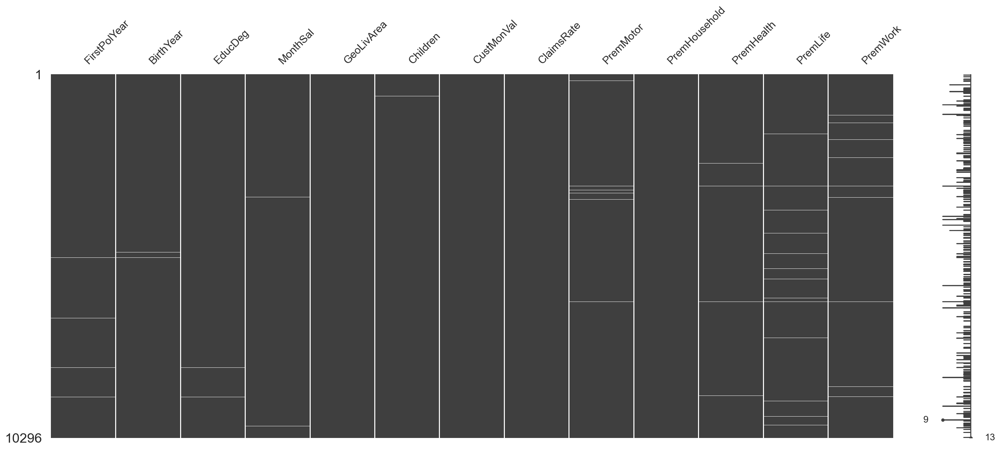

In [3598]:
msno.matrix(data)
plt.savefig(os.path.join('figures', 'missing_values_matrix.png'), dpi=200)
plt.show()

In [3599]:
# Categorical Variables
# Since non of our categorical variables have large numbers of missing values with can attribute the most frequent class
# to the missing values in hand

data_mvs = data.copy()
data_mvs['EducDeg'] = data_mvs['EducDeg'].fillna(data_mvs['EducDeg'].value_counts().index[0])
data_mvs['GeoLivArea'] = data_mvs['GeoLivArea'].fillna(data_mvs['GeoLivArea'].value_counts().index[0])
data_mvs['Children'] = data_mvs['Children'].fillna(data_mvs['Children'].value_counts().index[0])

In [3600]:
# As seen above, we don't have, percentually, many missing values percentually and many of them overlap in same records
# so we can choose to delete them. We lose information but gain a more robust model.

data_mvs = data_mvs.dropna()
print(str(round(100-((data_mvs.shape[0]/data.shape[0])*100),2))+ '% of the records in our Data were deleted')
data = data_mvs.copy()

2.87% of the records in our Data were deleted


##### Redefining some of the features types

In [3601]:
data['FirstPolYear'] = data['FirstPolYear'].astype('int64')
data['BirthYear'] = data['BirthYear'].astype('int64')
data['Children'] = data['Children'].astype('boolean')
data['GeoLivArea'] = data['GeoLivArea'].astype('category')

In [3602]:
# Rectify the educdeg type and simplifying it  

data['EducDeg'] = data['EducDeg'].astype('str')

label_dict = {"b'2 - High School'": "High School",
        "b'1 - Basic'" : 'Basic',
        "b'3 - BSc/MSc'": 'BSc/MSc',
        "b'4 - PhD'" : 'PhD',
        }

data['EducDeg'] = data['EducDeg'].map(label_dict)

# Renaming done so we change the type to category
data['EducDeg'] = data['EducDeg'].astype('category')

In [3603]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 1 to 10296
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   FirstPolYear   10000 non-null  int64   
 1   BirthYear      10000 non-null  int64   
 2   EducDeg        10000 non-null  category
 3   MonthSal       10000 non-null  float64 
 4   GeoLivArea     10000 non-null  category
 5   Children       10000 non-null  boolean 
 6   CustMonVal     10000 non-null  float64 
 7   ClaimsRate     10000 non-null  float64 
 8   PremMotor      10000 non-null  float64 
 9   PremHousehold  10000 non-null  float64 
 10  PremHealth     10000 non-null  float64 
 11  PremLife       10000 non-null  float64 
 12  PremWork       10000 non-null  float64 
dtypes: boolean(1), category(2), float64(8), int64(2)
memory usage: 898.8 KB


#### Outliers Investigation

In [3604]:
data.describe().T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
FirstPolYear,10000.0,NaN,NaN,NaN,1991.2003,518.021907,1974.0,1980.0,1986.0,1992.0,53784.0
BirthYear,10000.0,NaN,NaN,NaN,1968.0234,19.804956,1028.0,1953.0,1968.0,1983.0,2001.0
MonthSal,10000.0,NaN,NaN,NaN,2505.6479,1163.838177,333.0,1699.75,2501.5,3293.0,55215.0
Children,10000,2,True,7059,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CustMonVal,10000.0,NaN,NaN,NaN,177.828437,1973.966105,-165680.42,-8.22,188.04,399.86,11875.89
ClaimsRate,10000.0,NaN,NaN,NaN,0.745327,2.958832,0.0,0.3975,0.72,0.98,256.2
PremMotor,10000.0,NaN,NaN,NaN,298.962184,213.295658,-4.11,189.59,297.335,406.3,11604.42
PremHousehold,10000.0,NaN,NaN,NaN,212.96533,355.933374,-75.0,50.0,133.9,294.5,25048.8
PremHealth,10000.0,NaN,NaN,NaN,172.288564,299.871657,-2.11,112.02,163.03,219.93,28272.0
PremLife,10000.0,NaN,NaN,NaN,41.989188,47.605101,-7.0,9.89,25.56,57.9,398.3


In [3605]:
non_metric_features = ["FirstPolYear", "BirthYear", "EducDeg", "GeoLivArea", "Children"]
metric_features = data.columns.drop(non_metric_features).to_list()

#### FirstPolYear

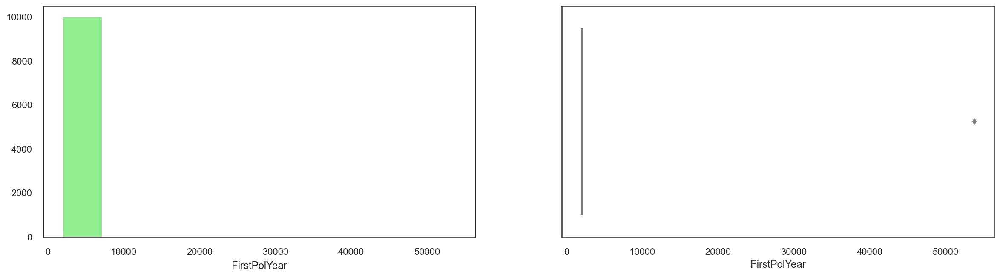

In [3606]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data['FirstPolYear']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'FirstPolYearOutliers.png'), dpi=200)
plt.show()

In [3607]:
data_1 = data.copy()[(data.copy()['FirstPolYear']<=2017) & (data.copy()['FirstPolYear']> 1960)]
print('Percentage of data kept after removing outliers:', np.round(data_1.shape[0] / data.shape[0], 4))

Percentage of data kept after removing outliers: 0.9999


#### BirthYear

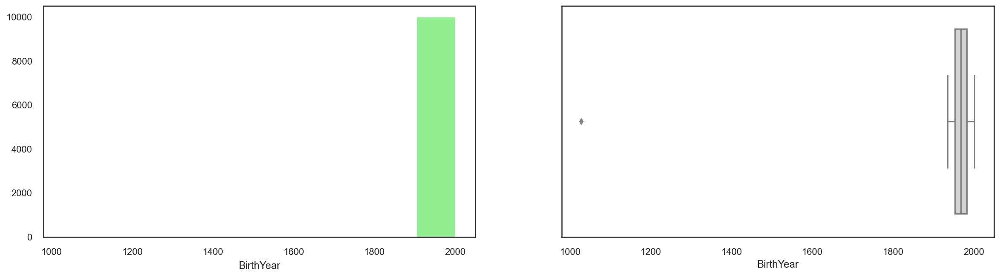

In [3608]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_1['BirthYear']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'BirthYearOutliers.png'), dpi=200)
plt.show()

In [3609]:
data_2 = data_1.copy()[data_1.copy()['BirthYear']>=1850] 
print('Percentage of data kept after removing outliers:', np.round(data_2.shape[0] / data_1.shape[0], 4))

Percentage of data kept after removing outliers: 0.9999


#### EducDeg

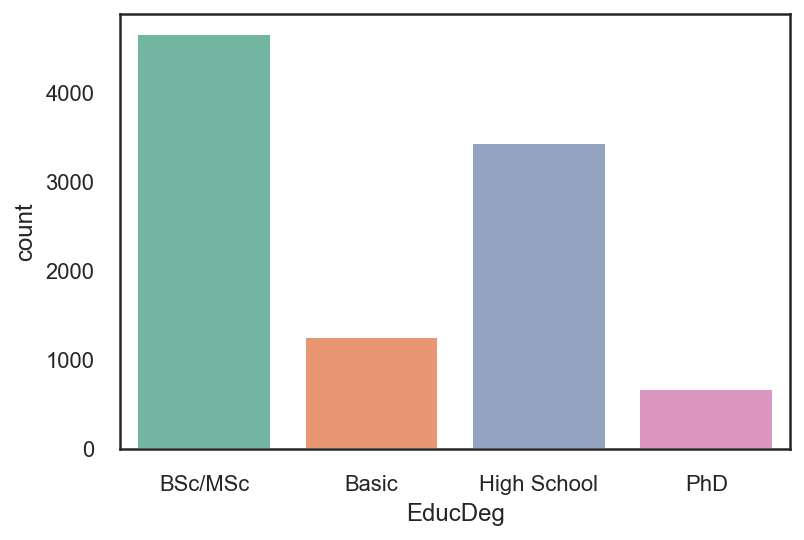

In [3610]:
sns.set()
sns.set_theme(style="white")
sns.countplot(x="EducDeg", data=data, palette = sns.color_palette("Set2"))

plt.savefig(os.path.join('figures', 'EducDegOutliers.png'), dpi=200)
plt.show()

#### MonthSal

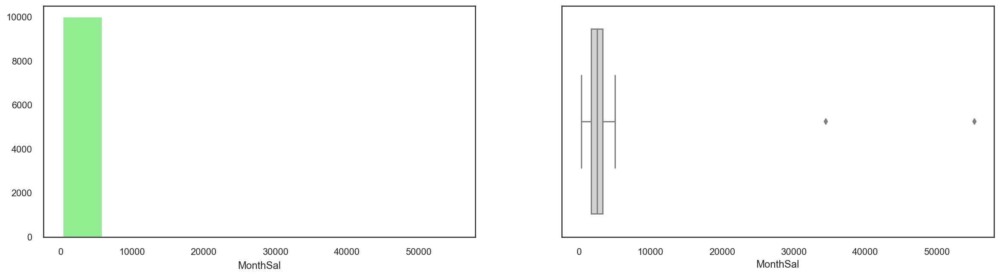

In [3611]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_2['MonthSal']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'MonthSalOutliers.png'), dpi=200)
plt.show()

In [3612]:
data_3 = data_2.copy()[data_2.copy()['MonthSal']<=30000] 
print('Percentage of data kept after removing outliers:', np.round(data_3.shape[0] / data_2.shape[0], 4))

Percentage of data kept after removing outliers: 0.9998


#### GeoLivArea

C:\Users\jrs\anaconda3\lib\site-packages\pandas\io\formats\format.py:1429: FutureWarning: Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.
  for val, m in zip(values.ravel(), mask.ravel())


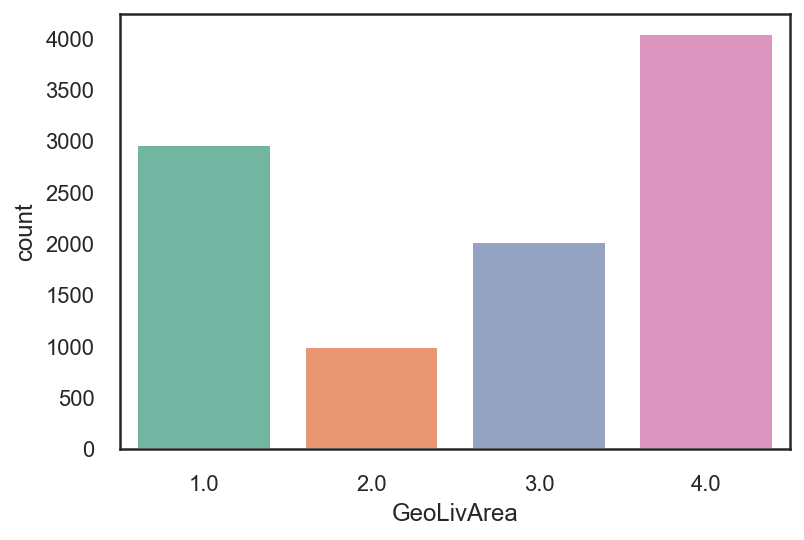

In [3613]:
sns.set()
sns.set_theme(style="white")
sns.countplot(x="GeoLivArea", data=data, palette = sns.color_palette("Set2"))

plt.savefig(os.path.join('figures', 'GeoLivAreaOutliers.png'), dpi=200)
plt.show()

#### Children

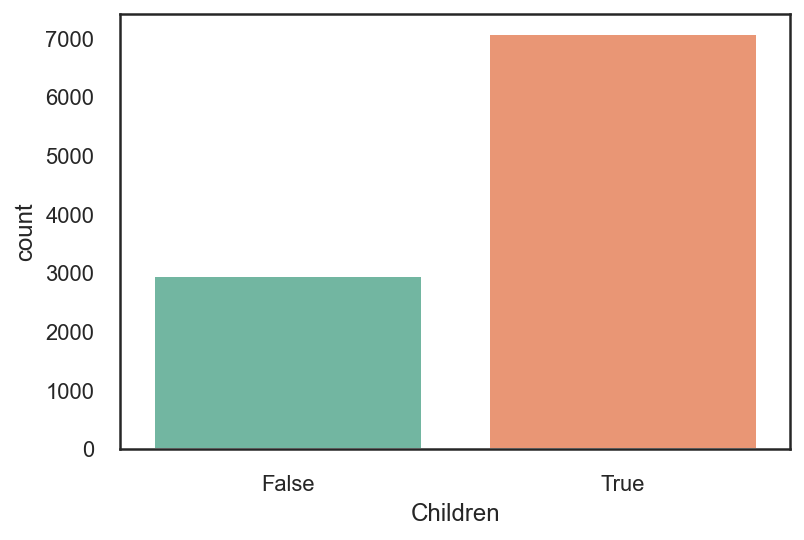

In [3614]:
sns.set()
sns.set_theme(style="white")
sns.countplot(x="Children", data=data, palette = sns.color_palette("Set2"))

plt.savefig(os.path.join('figures', 'ChildrenOutliers.png'), dpi=200)
plt.show()

#### ClaimsRate

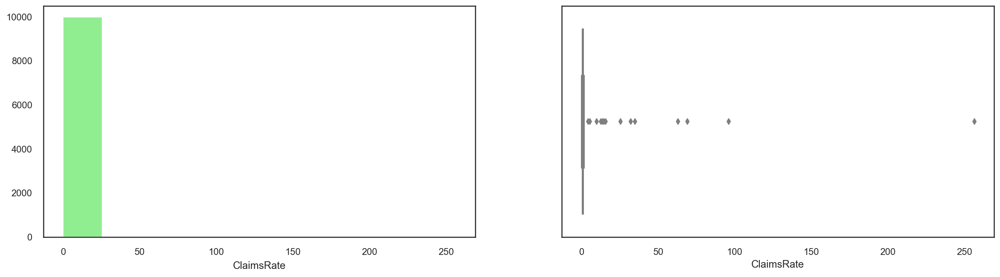

In [3615]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_3['ClaimsRate']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'ClaimsRateOutliers.png'), dpi=200)
plt.show()

In [3616]:
data_4 = data_3.copy()[(data_3.copy()['ClaimsRate'] < 50)]
print('Percentage of data kept after removing outliers:', np.round(data_4.shape[0] / data_3.shape[0], 4))

Percentage of data kept after removing outliers: 0.9996


#### CustMonVal

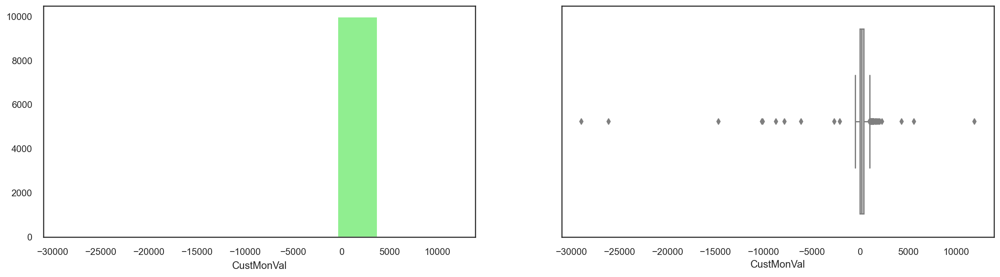

In [3617]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_4['CustMonVal']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'CustMonValOutliers.png'), dpi=200)
plt.show()

In [3618]:
data_5 = data_4.copy()[(data_4.copy()['CustMonVal'] < 1300) &  (data_4.copy()['CustMonVal'] > -1000)]
print('Percentage of data kept after removing outliers:', np.round(data_5.shape[0] / data_4.shape[0], 4))

Percentage of data kept after removing outliers: 0.9964


#### PremMotor

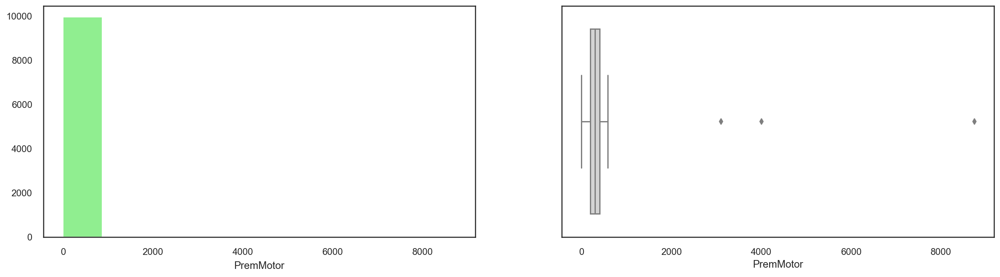

In [3619]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_5['PremMotor']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'PremMotorOutliers.png'), dpi=200)
plt.show()

In [3620]:
data_6 = data_5.copy()[data_5.copy()['PremMotor']<=1500] 
print('Percentage of data kept after removing outliers:', np.round(data_6.shape[0] / data_5.shape[0], 4))

Percentage of data kept after removing outliers: 0.9997


#### PremHousehold

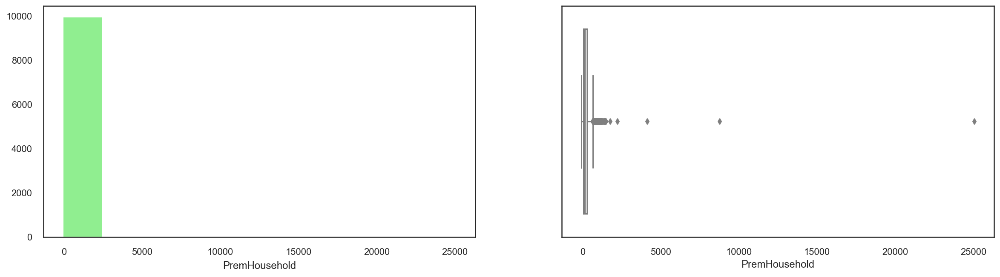

In [3621]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_6['PremHousehold']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'PremHouseholdOutliers.png'), dpi=200)
plt.show()

In [3622]:
data_7 = data_6.copy()[data_6.copy()['PremHousehold']<=1300] 
print('Percentage of data kept after removing outliers:', np.round(data_7.shape[0] / data_6.shape[0], 4))

Percentage of data kept after removing outliers: 0.998


#### PremHealth

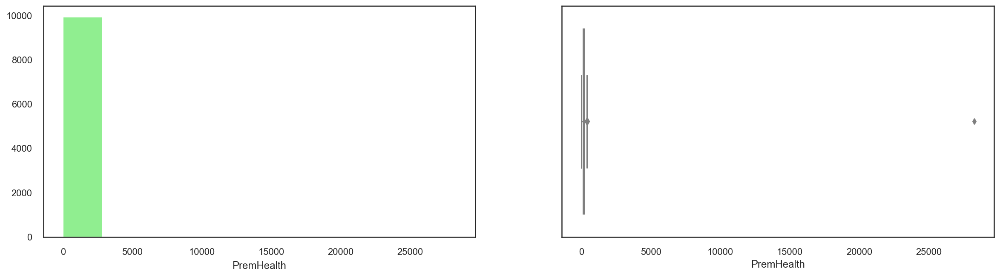

In [3623]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_7['PremHealth']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'PremHealthOutliers.png'), dpi=200)
plt.show()

In [3624]:
data_8 = data_7.copy()[data_7.copy()['PremHealth']<=410] 
print('Percentage of data kept after removing outliers:', np.round(data_8.shape[0] / data_7.shape[0], 4))

Percentage of data kept after removing outliers: 0.9994


#### PremWork

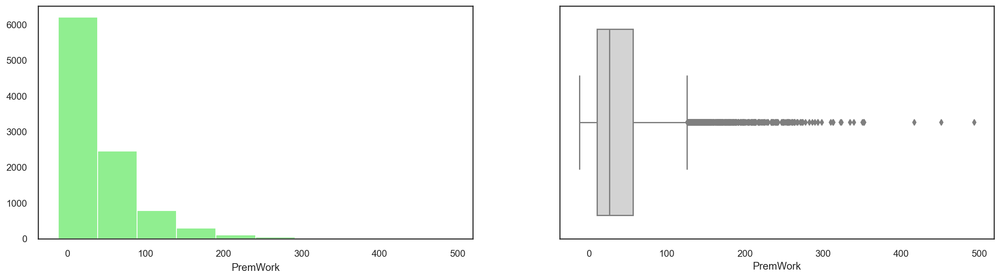

In [3625]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_8['PremWork']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'PremWorkOutliers.png'), dpi=200)
plt.show()

In [3626]:
data_9 = data_8.copy()[data_8.copy()['PremWork']<=300] 
print('Percentage of data kept after removing outliers:', np.round(data_9.shape[0] / data_8.shape[0], 4))

Percentage of data kept after removing outliers: 0.9986


#### PremLife

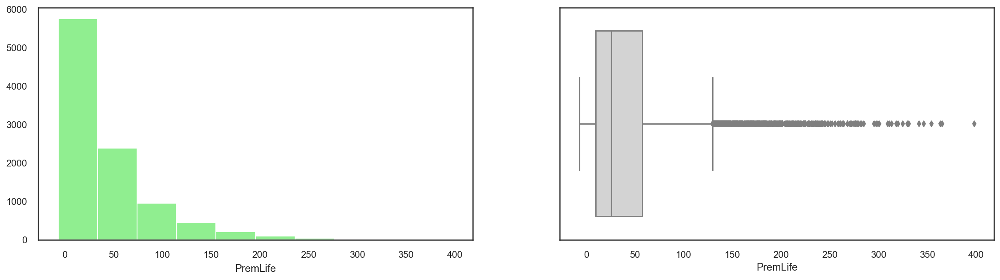

In [3627]:
sns.set()
sns.set_theme(style="white")
fig, axes = plt.subplots(1,2,figsize=(20, 5))
x = data_9['PremLife']
axes[0].hist(x,color = 'lightgreen')
axes[0].set_title(x.name, y=-0.16)
sns.boxplot(x=x, ax = axes[1],color = 'lightgrey')

plt.savefig(os.path.join('figures', 'PremLifeOutliers.png'), dpi=200)
plt.show()

In [3628]:
data_10 = data_9.copy()[data_9.copy()['PremLife']<=280]
print('Percentage of data kept after removing outliers:', np.round(data_9.shape[0] / data_8.shape[0], 4))

Percentage of data kept after removing outliers: 0.9986


In [3629]:
print('Percentage of data kept from the original dataset after removing outliers:', np.round(data_10.shape[0] / data.shape[0], 4))

Percentage of data kept from the original dataset after removing outliers: 0.9892


In [3630]:
data = data_10.copy()

### Let's visualize the aftermath...

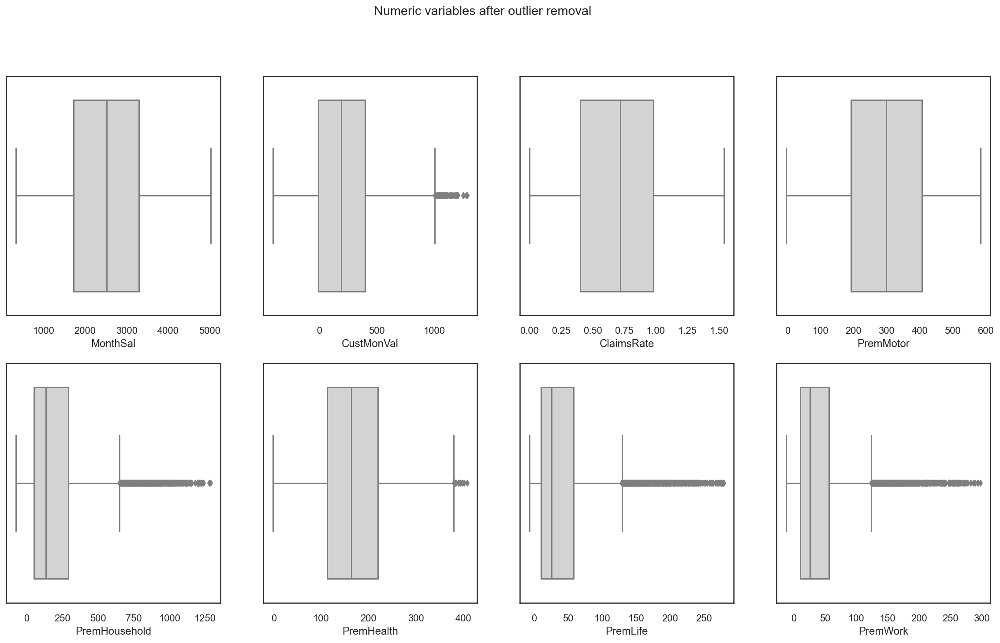

In [3631]:
# All Numeric Variables' Box Plots in one figure
sns.set()
sns.set_theme(style="white")

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data[feat], ax=ax, color = 'lightgrey')
    
title = "Numeric variables after outlier removal"

plt.suptitle(title)

plt.savefig(os.path.join('figures', 'numeric_variables_boxplots.png'), dpi=200)
plt.show()

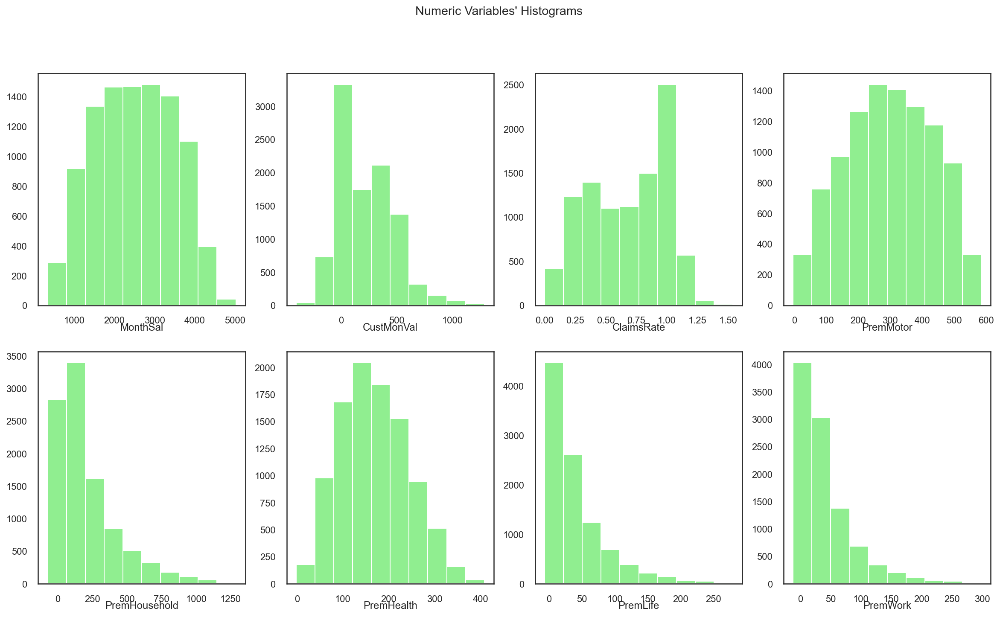

In [3632]:
# All Numeric Variables' Histograms in one figure
sns.set()
sns.set_theme(style="white")

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(data[feat], color = 'lightgreen')
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.savefig(os.path.join('figures', 'numeric_variables_histograms.png'), dpi=200)
plt.show()

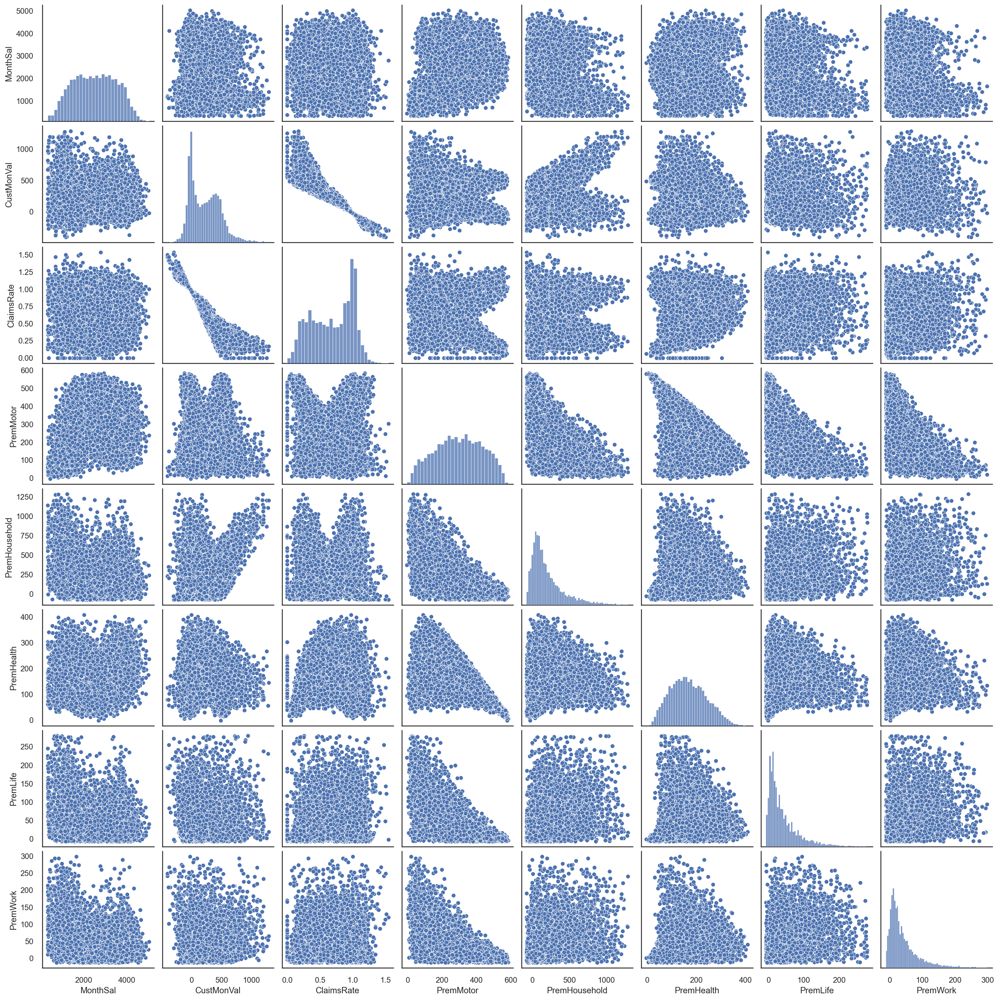

In [3633]:
# Basic correlogram of the metric features
sns.pairplot(data[metric_features])

plt.savefig(os.path.join('figures', 'correlogram.png'), dpi=200)
plt.show()

##### Coherence check

In [3634]:
# It doesn't make sense having a record with a firstPolYear value more recent than the BirthYear value
print("There's " + str(data.loc[data['FirstPolYear'] < data['BirthYear'], 'FirstPolYear'].count()) + " records affected.")

There's 1881 records affected.


In [3635]:
# We can start with reducing the amount of records affected, with a quick prediction of what the values in the 
# firstPolYear could be
# We chose to change the firstpolyear values since its more likely to have errors than birthyear

data_years = data.copy()
data_years = data_years[['FirstPolYear', "BirthYear", "MonthSal", "Children", "Children", "CustMonVal", "ClaimsRate", 
                         "PremMotor", "PremHousehold", "PremHealth", "PremLife", "PremWork"]]

data_years["Children"] = [1 if x==True else 0 for x in data_years["Children"]]

test_data = data_years.loc[data_years['FirstPolYear'] < data_years['BirthYear']]
data_years.dropna(inplace=True)

y_train = data_years.loc[data_years['FirstPolYear'] > data_years['BirthYear'], 'FirstPolYear']
X_train = data_years.loc[data_years['FirstPolYear'] > data_years['BirthYear']].drop("FirstPolYear", axis=1)
X_test = test_data.drop("FirstPolYear", axis=1)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_pred = y_pred.astype('int64')

data.loc[data['FirstPolYear'] < data['BirthYear'], 'FirstPolYear'] = y_pred

In [3636]:
print("There's is still " + str(data.loc[data['FirstPolYear'] < data['BirthYear'], 'FirstPolYear'].count()) + ' records affected')

There's is still 975 records affected


Futher down we'll be relabeling the FirstPolYear as decades instead of years and making it a nominal variable

## Feature Engineering

#### Redundancy

In [3637]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9892 entries, 1 to 10296
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   FirstPolYear   9892 non-null   int64   
 1   BirthYear      9892 non-null   int64   
 2   EducDeg        9892 non-null   category
 3   MonthSal       9892 non-null   float64 
 4   GeoLivArea     9892 non-null   category
 5   Children       9892 non-null   boolean 
 6   CustMonVal     9892 non-null   float64 
 7   ClaimsRate     9892 non-null   float64 
 8   PremMotor      9892 non-null   float64 
 9   PremHousehold  9892 non-null   float64 
 10  PremHealth     9892 non-null   float64 
 11  PremLife       9892 non-null   float64 
 12  PremWork       9892 non-null   float64 
dtypes: boolean(1), category(2), float64(8), int64(2)
memory usage: 889.1 KB


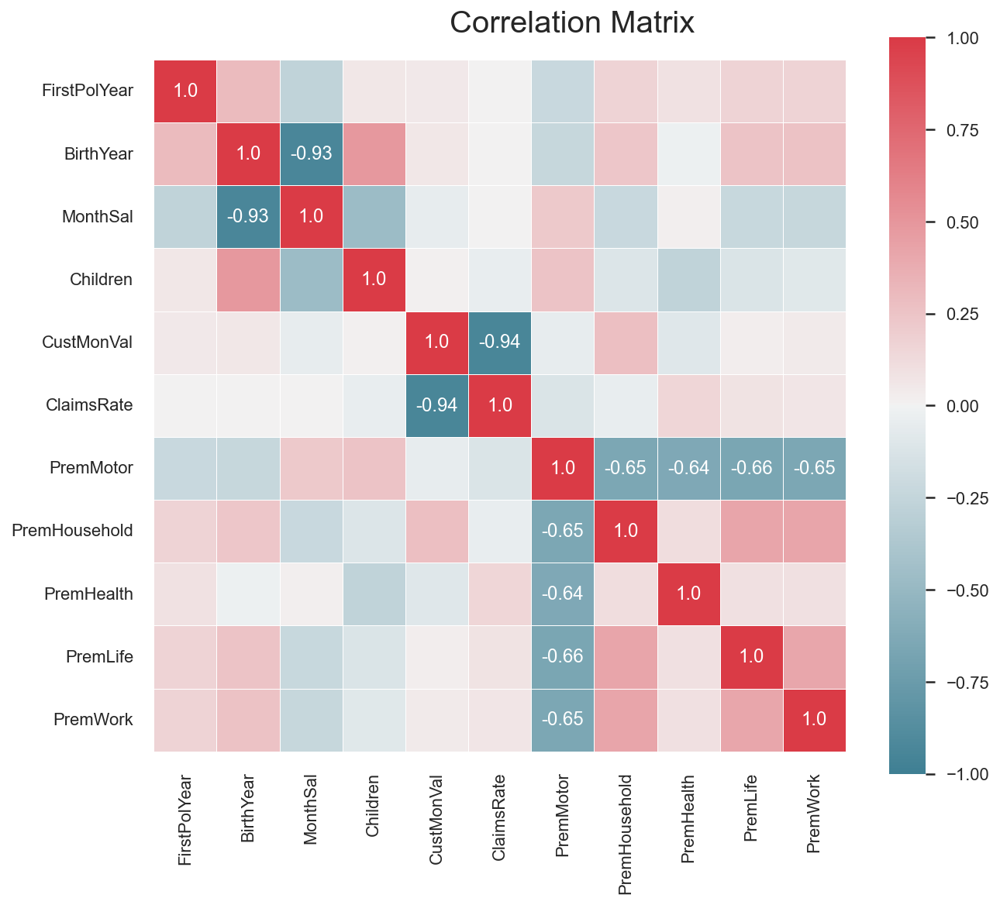

In [3638]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(data.corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.savefig(os.path.join('figures', 'correlation_matrix.png'), dpi=200)

plt.show()

In [3639]:
# We'll be removing BirthYear and CustMonVal since they are heavily (0.85+) correlated with MonthSal and ClaimsRate
# respectivly. We chose to remove BirthYear instead of MonthSal due its probably unreliable value as seen above.
# The removal of CustMonVal was simply because, besides the correlation with ClaimsRate, it had an higher correlation, 
#in this case a negative one, value with other variables than ClaimsRate

In [3640]:
data.drop(columns=['BirthYear', 'CustMonVal'], inplace=True)

In [3641]:
non_metric_features = ["FirstPolYear","EducDeg", "GeoLivArea", "Children"]
metric_features = data.columns.drop(non_metric_features).to_list()
metric_features

['MonthSal',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork']

### Data Normalization

In [3642]:
# https://machinelearningmastery.com/standardscaler-and-minmaxscaler-transforms-in-python/

In [3643]:
#Normality test for our variables

for feat in metric_features:
    stat, p = shapiro(data[feat])
    print('Normality test (Shapiro-Wilk Test) for the feature ' + feat)
    print('stat = ' + str(stat) + ', p= ' +str(p))
    
    if p > 0.05:
        print('We can assume the distribution of our variable is normal/gaussian.')
    else:
        print('We can assume the distribution of our variable is not normal/gaussian.\n')

Normality test (Shapiro-Wilk Test) for the feature MonthSal
stat = 0.9817761182785034, p= 1.1011631594094902e-33
We can assume the distribution of our variable is not normal/gaussian.

Normality test (Shapiro-Wilk Test) for the feature ClaimsRate
stat = 0.9455745816230774, p= 0.0
We can assume the distribution of our variable is not normal/gaussian.

Normality test (Shapiro-Wilk Test) for the feature PremMotor
stat = 0.9792600870132446, p= 1.5630150333405297e-35
We can assume the distribution of our variable is not normal/gaussian.

Normality test (Shapiro-Wilk Test) for the feature PremHousehold
stat = 0.8488250970840454, p= 0.0
We can assume the distribution of our variable is not normal/gaussian.

Normality test (Shapiro-Wilk Test) for the feature PremHealth
stat = 0.9874882698059082, p= 1.3236370025151752e-28
We can assume the distribution of our variable is not normal/gaussian.

Normality test (Shapiro-Wilk Test) for the feature PremLife
stat = 0.8064258098602295, p= 0.0
We can as

C:\Users\jrs\anaconda3\lib\site-packages\scipy\stats\morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


#### So, if it wasn't obvious enough from the histograms and boxplots above, we can confirm now that all of our data is not normally distributed and far from it. Therefore we will most likely use a Normalization scaling method as our preferred scalar method.

#### Min_Max

In [3644]:
data_minmax = data.copy()

In [3645]:
# Use MinMaxScaler to scale the data
scaler = MinMaxScaler()
scaled_feat = scaler.fit_transform(data_minmax[metric_features])
scaled_feat

array([[0.39334471, 0.25324675, 0.64473215, ..., 0.36166326, 0.18837193,
        0.09304348],
       [0.07337884, 0.72727273, 0.13841142, ..., 0.28938907, 0.70270647,
        0.38045089],
       [0.41467577, 0.18181818, 0.35677804, ..., 0.30860859, 0.32557896,
        0.35755233],
       ...,
       [0.55140785, 0.13636364, 0.69187043, ..., 0.35165156, 0.06860352,
        0.05439614],
       [0.34940273, 0.42207792, 0.32698149, ..., 0.48835623, 0.24727958,
        0.40228663],
       [0.52943686, 0.17532468, 0.70960243, ..., 0.34921563, 0.04844448,
        0.08016103]])

In [3646]:
# See what the fit method is doing (notice the trailing underscore):
print("Parameters fitted:\n", scaler.data_min_, "\n", scaler.data_max_)

Parameters fitted:
 [333.     0.    -4.11 -75.    -2.11  -7.   -12.  ] 
 [5.0210e+03 1.5400e+00 5.8522e+02 1.2869e+03 4.0841e+02 2.7972e+02
 2.9850e+02]


In [3647]:
data_minmax[metric_features] = scaled_feat
data_minmax.head()

,FirstPolYear,EducDeg,MonthSal,GeoLivArea,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,
1,1985,High School,0.393345,1.0,True,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043
2,1991,High School,0.073379,4.0,True,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451
3,1991,Basic,0.414676,3.0,False,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552
4,1990,BSc/MSc,0.163396,4.0,True,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919
5,1986,BSc/MSc,0.305034,4.0,True,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142


In [3648]:
# Checking max and min of minmaxed variables
data_minmax[metric_features].describe().round(2)

,MonthSal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
count,9892.00,9892.00,9892.00,9892.00,9892.00,9892.00,9892.00
mean,0.46,0.44,0.51,0.20,0.42,0.17,0.17
std,0.21,0.20,0.23,0.16,0.18,0.16,0.15
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.30,0.26,0.33,0.09,0.28,0.06,0.07
50%,0.47,0.47,0.51,0.15,0.40,0.11,0.12
75%,0.63,0.64,0.70,0.27,0.54,0.23,0.22
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00


#### StandardScaler

In [3649]:
data_standard = data.copy()

In [3650]:
scaler = StandardScaler()
scaled_feat = scaler.fit_transform(data_standard[metric_features])
scaled_feat

array([[-0.33627008, -0.92249888,  0.57576812, ..., -0.3051772 ,
         0.12619051, -0.52337063],
       [-1.86356476,  1.3901166 , -1.61063477, ..., -0.7071352 ,
         3.35121117,  1.44328486],
       [-0.23445044, -1.27097519, -0.66768029, ..., -0.60024445,
         0.98651677,  1.28659593],
       ...,
       [ 0.41821349, -1.49273284,  0.77932143, ..., -0.36085793,
        -0.62479077, -0.78782452],
       [-0.54601855, -0.09882761, -0.79634825, ...,  0.39943473,
         0.49555783,  1.59270132],
       [ 0.31333925, -1.30265485,  0.85589206, ..., -0.37440556,
        -0.75119356, -0.61152192]])

In [3651]:
# See what the fit method is doing (notice the trailing underscore):
print("Parameters fitted:\n", scaler.mean_, "\n", scaler.var_)

Parameters fitted:
 [2.50726051e+03 6.81195916e-01 2.97271870e+02 2.04135519e+02
 1.68886253e+02 4.12397068e+01 4.06387424e+01] 
 [9.64576862e+05 9.96411800e-02 1.86255087e+04 4.99935217e+04
 5.44845953e+03 2.09094379e+03 2.05902939e+03]


In [3652]:
data_standard[metric_features] = scaled_feat
data_standard.head()

,FirstPolYear,EducDeg,MonthSal,GeoLivArea,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,
1,1985,High School,-0.336270,1.0,True,-0.922499,0.575768,-0.557647,-0.305177,0.126191,-0.523371
2,1991,High School,-1.863565,4.0,True,1.390117,-1.610635,0.948443,-0.707135,3.351211,1.443285
3,1991,Basic,-0.234450,3.0,False,-1.270975,-0.667680,0.091079,-0.600244,0.986517,1.286596
4,1990,BSc/MSc,-1.433886,4.0,True,0.978281,-0.841118,-0.719101,1.927607,-0.129021,-0.271038
5,1986,BSc/MSc,-0.757803,4.0,True,0.693164,0.302972,-0.699199,0.185653,-0.491171,0.017878


In [3653]:
# Checking mean and variance of standardized variables
data_standard[metric_features].describe().round(2)

,MonthSal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
count,9892.00,9892.00,9892.00,9892.00,9892.00,9892.00,9892.00
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.21,-2.16,-2.21,-1.25,-2.32,-1.05,-1.16
25%,-0.81,-0.89,-0.77,-0.69,-0.76,-0.69,-0.66
50%,0.01,0.12,0.01,-0.32,-0.07,-0.34,-0.33
75%,0.80,0.95,0.80,0.38,0.69,0.36,0.34
max,2.56,2.72,2.11,4.84,3.24,5.22,5.68


#### We'll be choosing MinMaxScalar() as our preferred scalar method

In [3654]:
data = data_minmax.copy()
data

,FirstPolYear,EducDeg,MonthSal,GeoLivArea,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,
1,1985,High School,0.393345,1.0,True,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043
2,1991,High School,0.073379,4.0,True,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451
3,1991,Basic,0.414676,3.0,False,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552
4,1990,BSc/MSc,0.163396,4.0,True,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919
5,1986,BSc/MSc,0.305034,4.0,True,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142
...,...,...,...,...,...,...,...,...,...,...,...
10291,1992,Basic,0.062500,3.0,True,0.551948,0.018665,0.700125,0.256358,0.418597,0.686828
10292,1984,PhD,0.609002,2.0,False,0.623377,0.675089,0.091380,0.428530,0.058524,0.086248
10294,1994,BSc/MSc,0.551408,1.0,True,0.136364,0.691870,0.152581,0.351652,0.068604,0.054396


##  One-hot encoding

In [3655]:
# Before encoding the categorical features, we are going to relabel FirstPolYear so we can make it nominal with decades 
# instead of years

data.loc[(data['FirstPolYear'] >= 1970) & (data['FirstPolYear'] <= 1980), 'FirstPolYear'] = 70
data.loc[(data['FirstPolYear'] > 1980) & (data['FirstPolYear'] <= 1990), 'FirstPolYear'] = 80
data.loc[(data['FirstPolYear'] > 1990) & (data['FirstPolYear'] <= 2000), 'FirstPolYear'] = 90
data['FirstPolYear'] = data['FirstPolYear'].astype('category')

In [3656]:
data_ohc = data.copy()
data_ohc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9892 entries, 1 to 10296
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   FirstPolYear   9892 non-null   category
 1   EducDeg        9892 non-null   category
 2   MonthSal       9892 non-null   float64 
 3   GeoLivArea     9892 non-null   category
 4   Children       9892 non-null   boolean 
 5   ClaimsRate     9892 non-null   float64 
 6   PremMotor      9892 non-null   float64 
 7   PremHousehold  9892 non-null   float64 
 8   PremHealth     9892 non-null   float64 
 9   PremLife       9892 non-null   float64 
 10  PremWork       9892 non-null   float64 
dtypes: boolean(1), category(3), float64(7)
memory usage: 667.1 KB


In [3657]:
non_metric_features.remove("Children") # since its a boolean we might as well just change the type
data_ohc['Children'] = data_ohc['Children'].astype('float64')

In [3658]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False)
ohc_feat = ohc.fit_transform(data_ohc[non_metric_features])
ohc_feat_names = ohc.get_feature_names()
ohc_df = pd.DataFrame(ohc_feat, index=data_ohc.index, columns=ohc_feat_names)  # Why the index=df_ohc.index?
ohc_df

,x0_70,x0_80,x0_90,x1_BSc/MSc,x1_Basic,x1_High School,x1_PhD,x2_1.0,x2_2.0,x2_3.0,x2_4.0
CustID,,,,,,,,,,,
1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
10291,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
10292,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
10294,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [3659]:
# Reassigning df to contain ohc variables
data_ohc = pd.concat([data_ohc.drop(columns=non_metric_features), ohc_df], axis=1)
data_ohc.head()

,MonthSal,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_70,x0_80,x0_90,x1_BSc/MSc,x1_Basic,x1_High School,x1_PhD,x2_1.0,x2_2.0,x2_3.0,x2_4.0
CustID,,,,,,,,,,,,,,,,,,,
1,0.393345,1.0,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
2,0.073379,1.0,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,0.414676,0.0,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.163396,1.0,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5,0.305034,1.0,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [3660]:
data = data_ohc.copy()

In [3661]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9892 entries, 1 to 10296
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   MonthSal        9892 non-null   float64
 1   Children        9892 non-null   float64
 2   ClaimsRate      9892 non-null   float64
 3   PremMotor       9892 non-null   float64
 4   PremHousehold   9892 non-null   float64
 5   PremHealth      9892 non-null   float64
 6   PremLife        9892 non-null   float64
 7   PremWork        9892 non-null   float64
 8   x0_70           9892 non-null   float64
 9   x0_80           9892 non-null   float64
 10  x0_90           9892 non-null   float64
 11  x1_BSc/MSc      9892 non-null   float64
 12  x1_Basic        9892 non-null   float64
 13  x1_High School  9892 non-null   float64
 14  x1_PhD          9892 non-null   float64
 15  x2_1.0          9892 non-null   float64
 16  x2_2.0          9892 non-null   float64
 17  x2_3.0          9892 non-null   

## PCA

In [3662]:
# https://towardsdatascience.com/understand-your-data-with-principle-component-analysis-pca-and-discover-underlying-patterns-d6cadb020939

In [3663]:
df_pca = data.copy()

In [3664]:
# Use PCA to reduce dimensionality of data
pca = PCA()
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat

array([[-0.16320227, -0.17636874, -0.05797974, ...,  0.09583688,
        -0.02695269, -0.01615369],
       [ 0.65419327, -0.18529902,  0.38808852, ...,  0.25005356,
        -0.06214919,  0.01144631],
       [ 0.17574526, -0.24769719, -0.17545219, ...,  0.12125386,
         0.12695969,  0.03227461],
       ...,
       [-0.29044177, -0.1460702 , -0.23374434, ..., -0.00333391,
        -0.02883203, -0.00111084],
       [ 0.27804373, -0.06310576,  0.00488158, ...,  0.04343178,
         0.17079296, -0.01937052],
       [-0.30298379, -0.13560922, -0.18427851, ..., -0.00569306,
         0.00785689, -0.00587898]])

In [3665]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.103944,0.000000,0.423168,0.423168
2,0.046764,-0.057180,0.190383,0.613551
3,0.039351,-0.007413,0.160205,0.773756
4,0.027205,-0.012147,0.110754,0.884510
5,0.014796,-0.012408,0.060238,0.944749
6,0.013280,-0.001516,0.054065,0.998814
7,0.000291,-0.012989,0.001186,1.000000


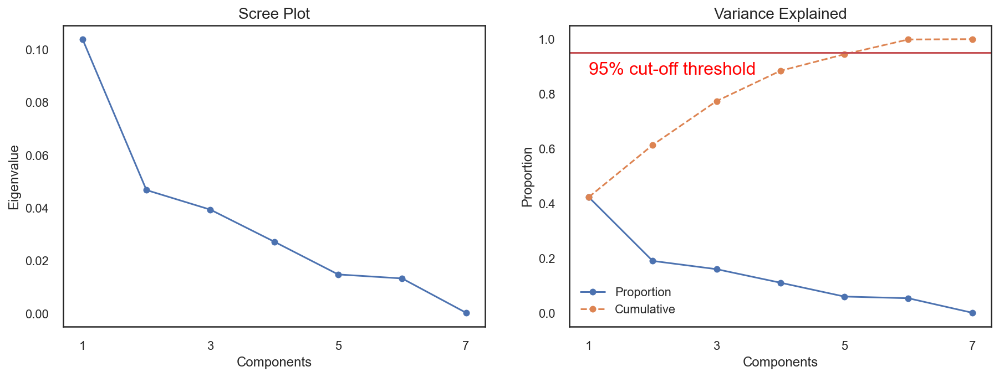

In [3666]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")
ax2.axhline(y=0.95, color='r', linestyle='-')
ax2.text(0, 0.87, '95% cut-off threshold', color = 'red', fontsize=16)

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.savefig(os.path.join('figures', 'PCAcomponents.png'), dpi=200)
plt.show()

# https://www.mikulskibartosz.name/pca-how-to-choose-the-number-of-components/

#### Typically, we want the explained variance to be between 95–99%. 5 components might do the trick.

In [3667]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=5)
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2,PC3,PC4
CustID,,,,,
1,-0.163202,-0.176369,-0.057980,-0.069776,0.095837
2,0.654193,-0.185299,0.388089,0.252669,0.250054
3,0.175745,-0.247697,-0.175452,0.106208,0.121254
4,0.279075,0.118834,0.235040,-0.392740,0.048741
5,-0.051160,0.015112,0.218841,-0.128490,0.001514
...,...,...,...,...,...
10291,0.827033,-0.353792,0.204956,0.326188,-0.186712
10292,-0.230435,0.224045,0.093488,-0.002423,-0.019216
10294,-0.290442,-0.146070,-0.233744,-0.053201,-0.003334


In [3668]:
df_pca = pd.concat([df_pca, pca_df], axis=1)
df_pca.head()

,MonthSal,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_70,x0_80,...,x1_PhD,x2_1.0,x2_2.0,x2_3.0,x2_4.0,PC0,PC1,PC2,PC3,PC4
CustID,,,,,,,,,,,,,,,,,,,,,
1,0.393345,1.0,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,-0.163202,-0.176369,-0.057980,-0.069776,0.095837
2,0.073379,1.0,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.654193,-0.185299,0.388089,0.252669,0.250054
3,0.414676,0.0,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.175745,-0.247697,-0.175452,0.106208,0.121254
4,0.163396,1.0,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.279075,0.118834,0.235040,-0.392740,0.048741
5,0.305034,1.0,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,-0.051160,0.015112,0.218841,-0.128490,0.001514


In [3669]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4
MonthSal,-0.377060,0.662846,-0.545337,0.347512,0.006268
ClaimsRate,0.174011,0.630052,0.737731,0.155460,-0.058688
PremMotor,-0.979676,-0.111839,0.155299,0.017683,-0.014400
PremHousehold,0.692802,-0.223630,-0.144691,0.333586,-0.495663
PremHealth,0.553939,0.496492,-0.219989,-0.628530,-0.000571
PremLife,0.697221,-0.131101,0.011772,0.360203,0.558669
PremWork,0.674942,-0.132038,0.012049,0.290166,-0.059997


In [3670]:
data = df_pca.copy()

### Extra Data exploration with pandas profilling

In [3671]:
profile = ProfileReport(
    data, 
    title='Insurance Com',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3672]:
# After exploring the report generated with can see that the a newly create PCA varaible (PC0) is highly correlated
# with PremMotor
data.drop(columns=['PC0'], inplace=True)

In [3673]:
pca_features = ['PC1','PC2','PC3','PC4']

In [3674]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9892 entries, 1 to 10296
Data columns (total 23 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   MonthSal        9892 non-null   float64
 1   Children        9892 non-null   float64
 2   ClaimsRate      9892 non-null   float64
 3   PremMotor       9892 non-null   float64
 4   PremHousehold   9892 non-null   float64
 5   PremHealth      9892 non-null   float64
 6   PremLife        9892 non-null   float64
 7   PremWork        9892 non-null   float64
 8   x0_70           9892 non-null   float64
 9   x0_80           9892 non-null   float64
 10  x0_90           9892 non-null   float64
 11  x1_BSc/MSc      9892 non-null   float64
 12  x1_Basic        9892 non-null   float64
 13  x1_High School  9892 non-null   float64
 14  x1_PhD          9892 non-null   float64
 15  x2_1.0          9892 non-null   float64
 16  x2_2.0          9892 non-null   float64
 17  x2_3.0          9892 non-null   

In [3675]:
non_metric_features = ["x0_70", "x0_80", "x0_90", "x1_BSc/MSc", "x1_Basic", "x1_High School", 
                       "x1_PhD", "x2_1.0", "x2_2.0", "x2_3.0", "x2_4.0", "Children"]
metric_features = data.columns.drop(non_metric_features + pca_features).to_list()

## DBSCAN

In [3676]:
len(metric_features)

7

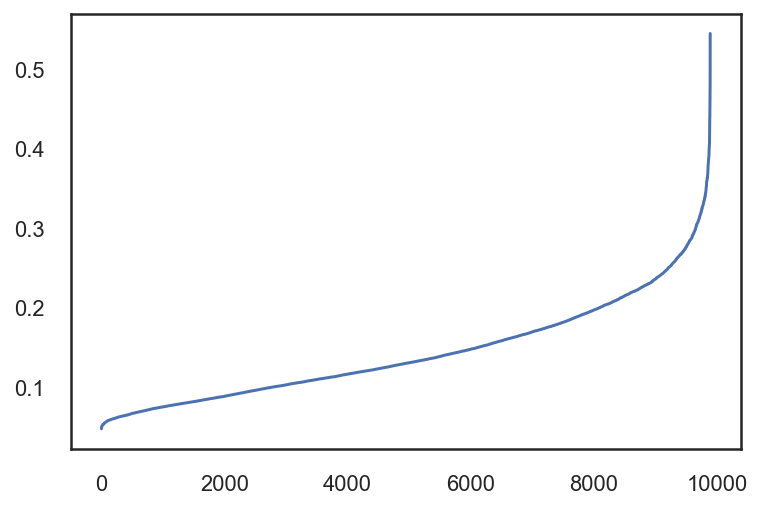

In [3677]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=13)
neigh.fit(data[metric_features])
distances, _ = neigh.kneighbors(data[metric_features])
distances = np.sort(distances[:, -1])
plt.plot(distances)

plt.savefig(os.path.join('figures', 'dbscanEpsValue.png'), dpi=200)
plt.show()

In [3678]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.25, min_samples=13, n_jobs=4)
dbscan_labels = dbscan.fit_predict(data[metric_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


In [3679]:
# Concatenating the labels to df
df_concat_db = pd.concat([data[metric_features], pd.Series(dbscan_labels, index=data.index, name="dbscan_labels")], axis=1)
df_concat_db

C:\Users\jrs\anaconda3\lib\site-packages\IPython\core\displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


,MonthSal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
CustID,,,,,,,,
1,0.393345,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043,0
2,0.073379,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451,0
3,0.414676,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552,0
4,0.163396,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919,0
5,0.305034,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142,0
...,...,...,...,...,...,...,...,...
10291,0.062500,0.551948,0.018665,0.700125,0.256358,0.418597,0.686828,0
10292,0.609002,0.623377,0.675089,0.091380,0.428530,0.058524,0.086248,0
10294,0.551408,0.136364,0.691870,0.152581,0.351652,0.068604,0.054396,0


In [3680]:
# Detecting noise (potential outliers)
len(df_concat_db.loc[df_concat_db['dbscan_labels'] == -1])

197

In [3681]:
data['dbscan_labels_mf'] = dbscan_labels

In [3682]:
# Save the outliers, since we might add them in a later stage

data_outliers_dbscan = data[data['dbscan_labels_mf'] == -1]

In [3683]:
data = data[data['dbscan_labels_mf']!=-1]
data

,MonthSal,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_70,x0_80,...,x1_PhD,x2_1.0,x2_2.0,x2_3.0,x2_4.0,PC1,PC2,PC3,PC4,dbscan_labels_mf
CustID,,,,,,,,,,,,,,,,,,,,,
1,0.393345,1.0,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,-0.176369,-0.057980,-0.069776,0.095837,0
2,0.073379,1.0,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,-0.185299,0.388089,0.252669,0.250054,0
3,0.414676,0.0,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,-0.247697,-0.175452,0.106208,0.121254,0
4,0.163396,1.0,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.118834,0.235040,-0.392740,0.048741,0
5,0.305034,1.0,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.015112,0.218841,-0.128490,0.001514,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10291,0.062500,1.0,0.551948,0.018665,0.700125,0.256358,0.418597,0.686828,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,-0.353792,0.204956,0.326188,-0.186712,0
10292,0.609002,0.0,0.623377,0.675089,0.091380,0.428530,0.058524,0.086248,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.224045,0.093488,-0.002423,-0.019216,0
10294,0.551408,1.0,0.136364,0.691870,0.152581,0.351652,0.068604,0.054396,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,-0.146070,-0.233744,-0.053201,-0.003334,0


In [3684]:
print("Percentage of data removed after, the preparation and pre-processing fase: " + str(round((100 - (len(data)/10296)*100), 2)) + "%")

Percentage of data removed after, the preparation and pre-processing fase: 5.84%


# Data visualization

In [3685]:
# This is step can be quite time consuming
two_dim = TSNE(random_state=51).fit_transform(data[metric_features])

In [3686]:
matplotlib_axes_logger.setLevel('ERROR')

In [3687]:
mapper = umap.UMAP(min_dist = 1 , n_neighbors= 15).fit(data[metric_features])
mapper_snd = umap.UMAP().fit(data[metric_features])

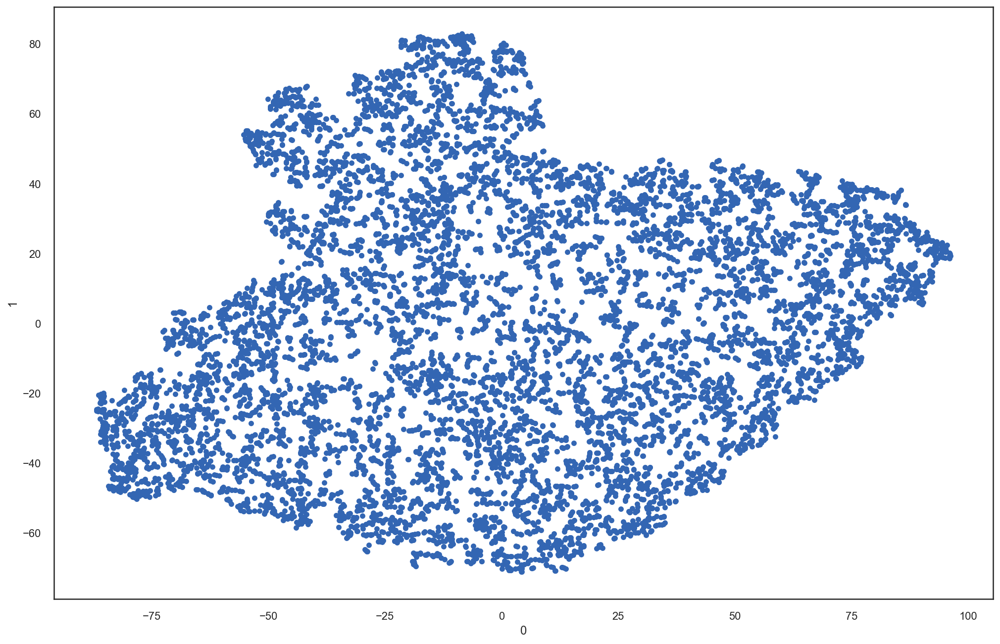

In [3688]:
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, color=(0.2,0.4,0.7), figsize=(17,11))

plt.show()

<AxesSubplot:>

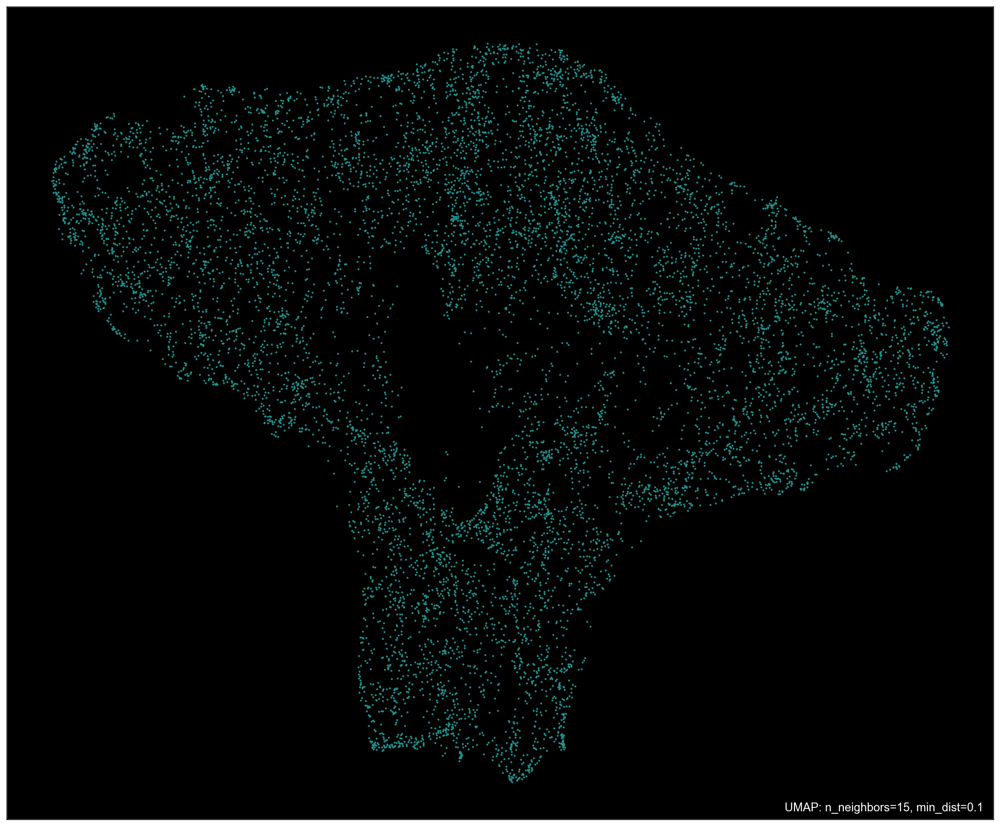

In [3689]:
umap.plot.points(mapper_snd, theme = 'viridis', background='black', color_key = '#126632', width = 1300 , height = 1100)

<AxesSubplot:>

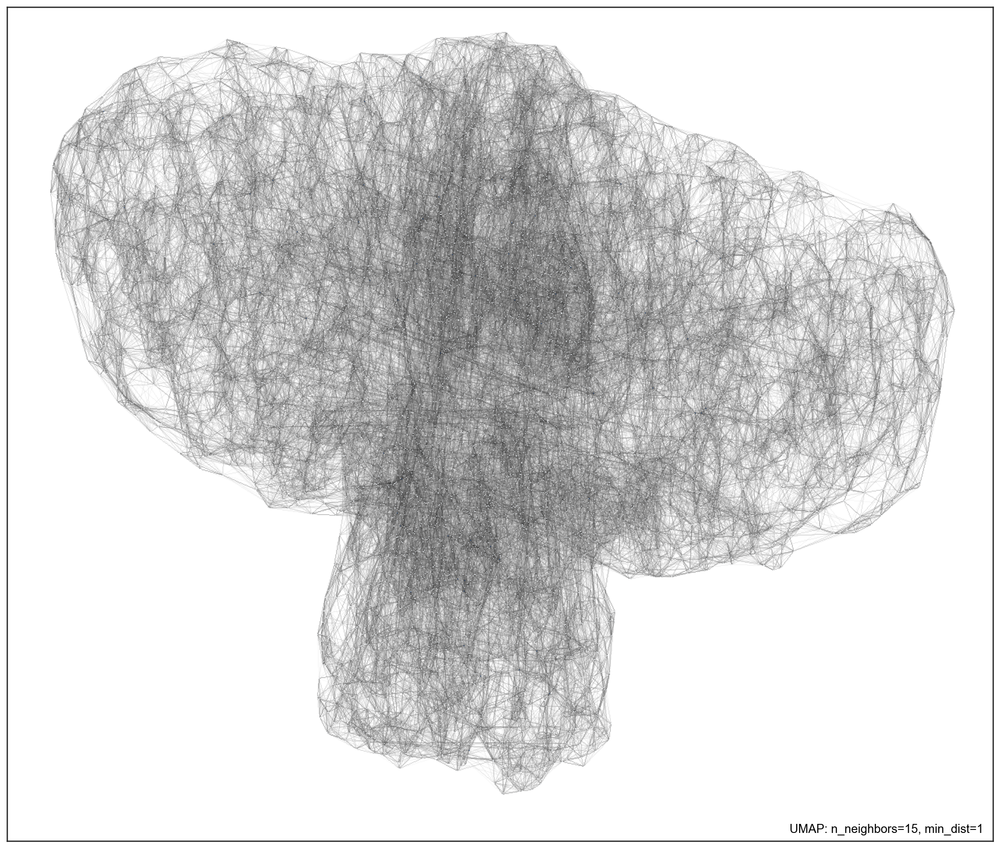

In [3690]:
umap.plot.connectivity(mapper, show_points=True, width = 1300 , height = 1100)

C:\Users\jrs\anaconda3\lib\site-packages\umap\plot.py:885: UserWarning: Hammer edge bundling is expensive for large graphs!
This may take a long time to compute!
  warn(


<AxesSubplot:>

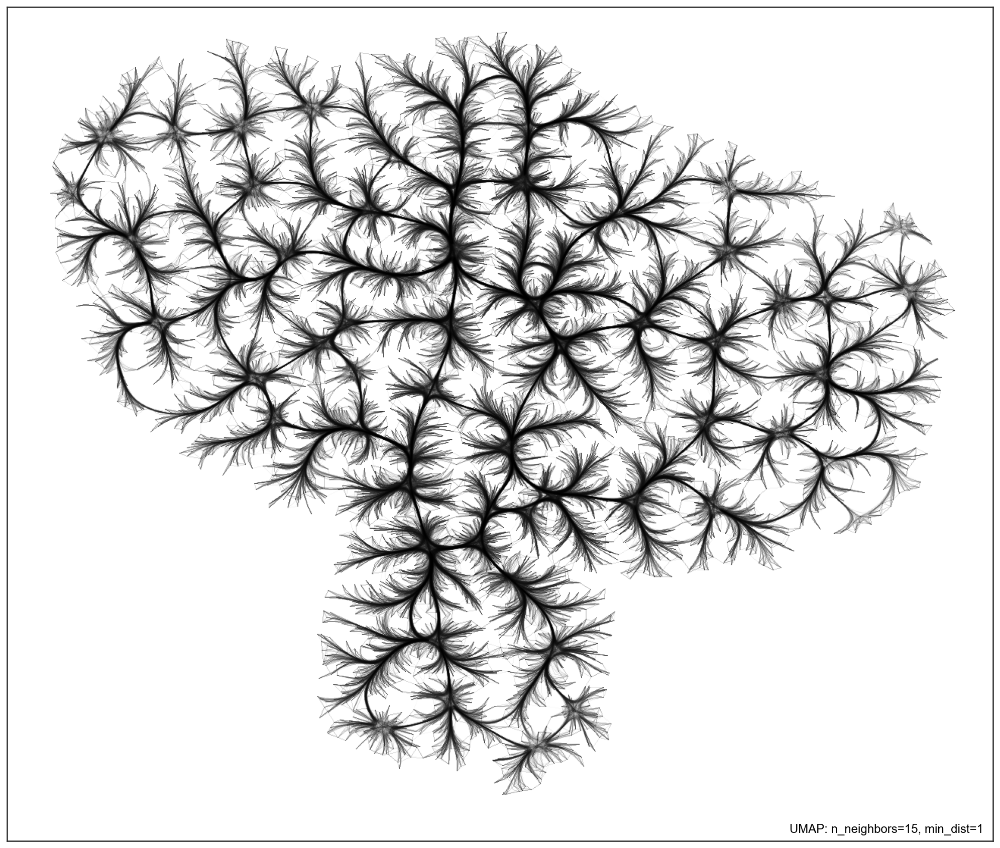

In [3691]:
umap.plot.connectivity(mapper, edge_bundling='hammer', width = 1300 , height = 1100)

# Clustering Using our Metric Features

## Hierarchical Clustering

In [3692]:
def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    """This function computes the R2 for a set of cluster solutions given by the application of a hierarchical method.
    The R2 is a measure of the homogenity of a cluster solution. It is based on SSt = SSw + SSb and R2 = SSb/SSt. 
    
    Parameters:
    df (DataFrame): Dataset to apply clustering
    link_method (str): either "ward", "complete", "average", "single"
    max_nclus (int): maximum number of clusters to compare the methods
    min_nclus (int): minimum number of clusters to compare the methods. Defaults to 1.
    dist (str): distance to use to compute the clustering solution. Must be a valid distance. Defaults to "euclidean".
    
    Returns:
    ndarray: R2 values for the range of cluster solutions
    """
    def get_ss(df):
        ss = np.sum(df.var() * (df.count() - 1))
        return ss  # return sum of sum of squares of each df variable
    
    sst = get_ss(df)  # get total sum of squares
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        cluster = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link_method)
        
        
        hclabels = cluster.fit_predict(df) #get cluster labels
        
        
        df_concat = pd.concat((df, pd.Series(hclabels, name='labels')), axis=1)  # concat df with labels
        
        
        ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
        
        
        ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
        
        
        r2.append(ssb / sst)  # save the R2 of the given cluster solution
        
    return np.array(r2)

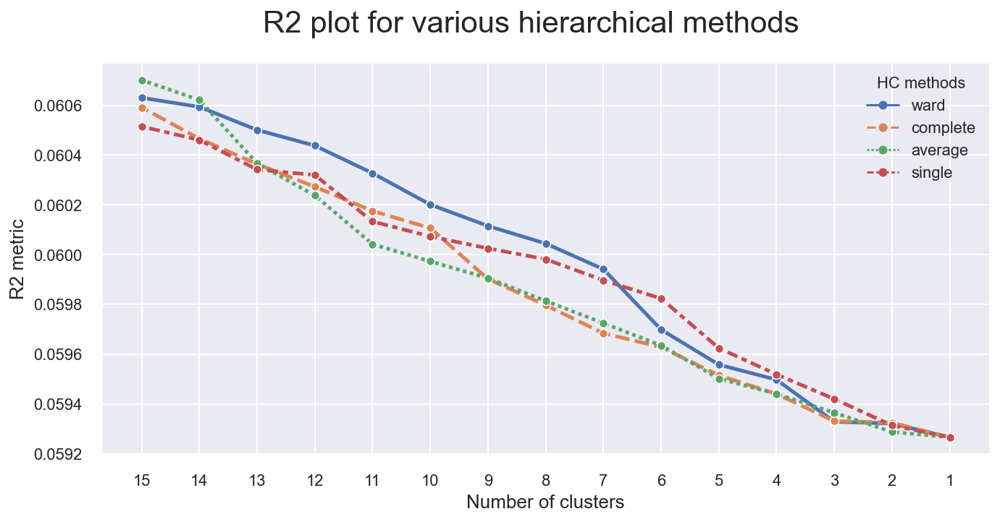

In [3693]:
# Prepare input
hc_methods = ["ward", "complete", "average", "single"]
# Call function defined above to obtain the R2 statistic for each hc_method
max_nclus = 15
r2_hc_methods = np.vstack(
    [
        get_r2_hc(df=data[metric_features], link_method=link, max_nclus=max_nclus) 
        for link in hc_methods
    ]
).T
r2_hc_methods = pd.DataFrame(r2_hc_methods, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=21)
plt.gca().invert_xaxis()  # invert x axis
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

plt.show()

In [3694]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(data[metric_features])

array([8419, 8877, 8575, ...,    2,    1,    0], dtype=int64)

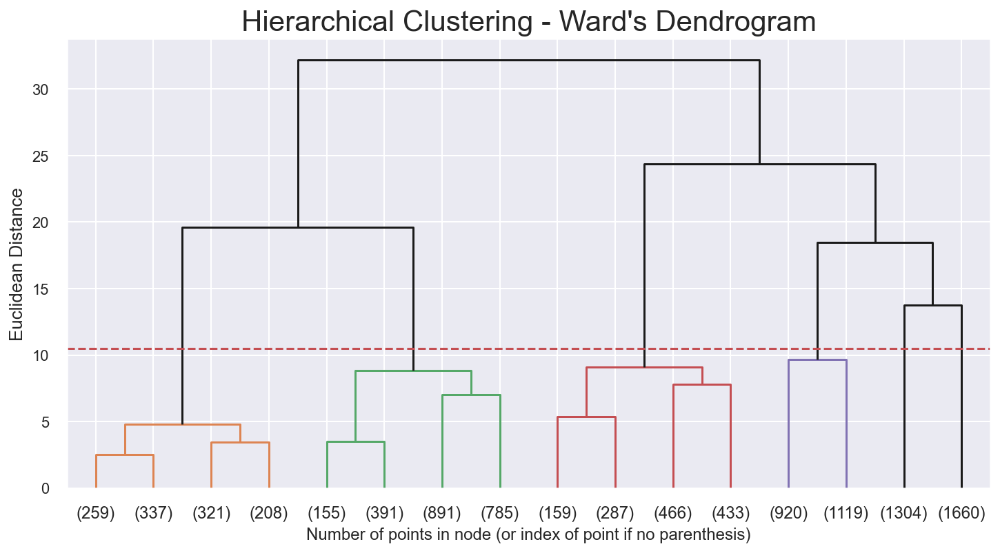

In [3695]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(12,6))
# The Dendrogram parameters need to be tuned
y_threshold = 10.5
dendrogram(linkage_matrix, truncate_mode='level', p = 3,  color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

### Final Solution

#### More the distance of the vertical lines in the dendrogram, more the distance between those clusters.
Based on this dendrogram with complete linkage, using 5 clusters might be the best way to cluster our data

In [3696]:
# 6 cluster solution
linkage = 'ward'
distance = 'euclidean'
hc4lust = AgglomerativeClustering(linkage=linkage, affinity=distance, n_clusters=6)
hc4_labels = hc4lust.fit_predict(data[metric_features])

In [3697]:
# Characterizing the 6 clusters
df_concat_hc = pd.concat((data, pd.Series(hc4_labels, name='labels')), axis=1)
df_concat_hc.groupby('labels').mean()

,MonthSal,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_70,x0_80,...,x1_PhD,x2_1.0,x2_2.0,x2_3.0,x2_4.0,PC1,PC2,PC3,PC4,dbscan_labels_mf
labels,,,,,,,,,,,,,,,,,,,,,
0.0,0.460747,0.718406,0.449305,0.519038,0.198753,0.416825,0.163181,0.164745,0.170425,0.449397,...,0.068170,0.280545,0.104352,0.209754,0.405349,0.003381,0.009048,-0.005062,-0.000145,0.0
1.0,0.473780,0.707097,0.436376,0.515343,0.202140,0.420905,0.161718,0.163550,0.175484,0.466452,...,0.067097,0.302581,0.095484,0.206452,0.395484,0.005830,-0.010228,-0.004387,-0.001880,0.0
2.0,0.466562,0.714510,0.443748,0.517410,0.201283,0.420127,0.163314,0.161814,0.169412,0.454902,...,0.072941,0.284706,0.094902,0.195294,0.425098,0.005175,0.000181,-0.005739,-0.000874,0.0
3.0,0.477069,0.710526,0.435285,0.525846,0.198418,0.416775,0.152600,0.162075,0.182331,0.447368,...,0.073308,0.296053,0.089286,0.207707,0.406955,0.005972,-0.009880,-0.004846,-0.006103,0.0
4.0,0.462973,0.698715,0.439695,0.515098,0.201808,0.420319,0.166164,0.162285,0.166587,0.457877,...,0.063303,0.306997,0.106140,0.194669,0.392194,0.000398,-0.001330,-0.007008,0.001253,0.0
5.0,0.462197,0.709283,0.453467,0.520240,0.201996,0.417910,0.159725,0.162071,0.171824,0.451954,...,0.074919,0.306189,0.090391,0.190554,0.412866,0.007125,0.010942,-0.005146,-0.005083,0.0


In [3698]:
data['hc_labels_mf'] = hc4_labels

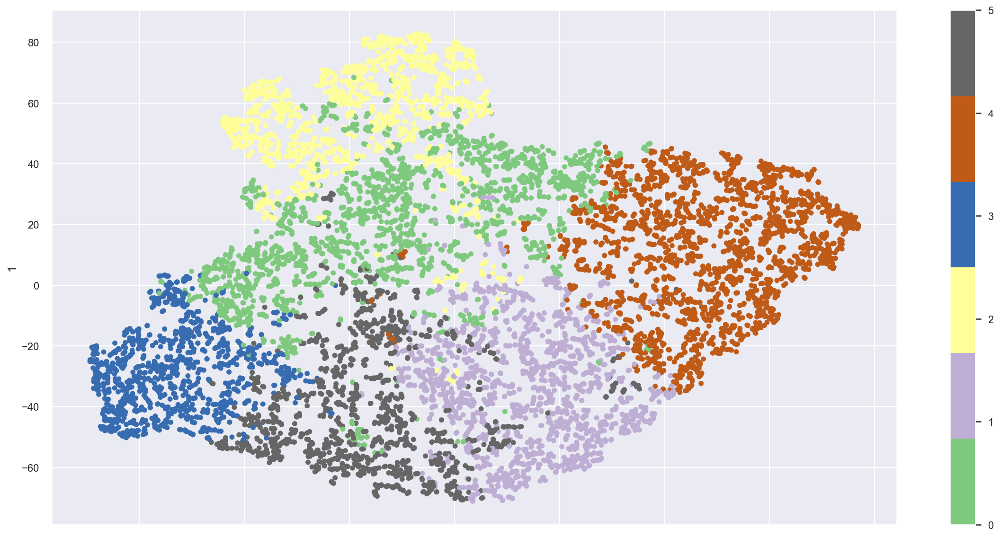

In [3770]:
Accent = cm.get_cmap('Accent', 6)

# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=data['hc_labels_mf'], colormap= Accent, figsize=(20,10))
plt.savefig(os.path.join('figures', 'tsne_hc_mf.png'), dpi=200)
plt.show()

#### UMAP

In [3700]:
manifold = umap.UMAP(min_dist = 0.7 , n_neighbors = 10).fit(data[metric_features], data['hc_labels_mf'])
X_reduced = manifold.transform(data[metric_features])

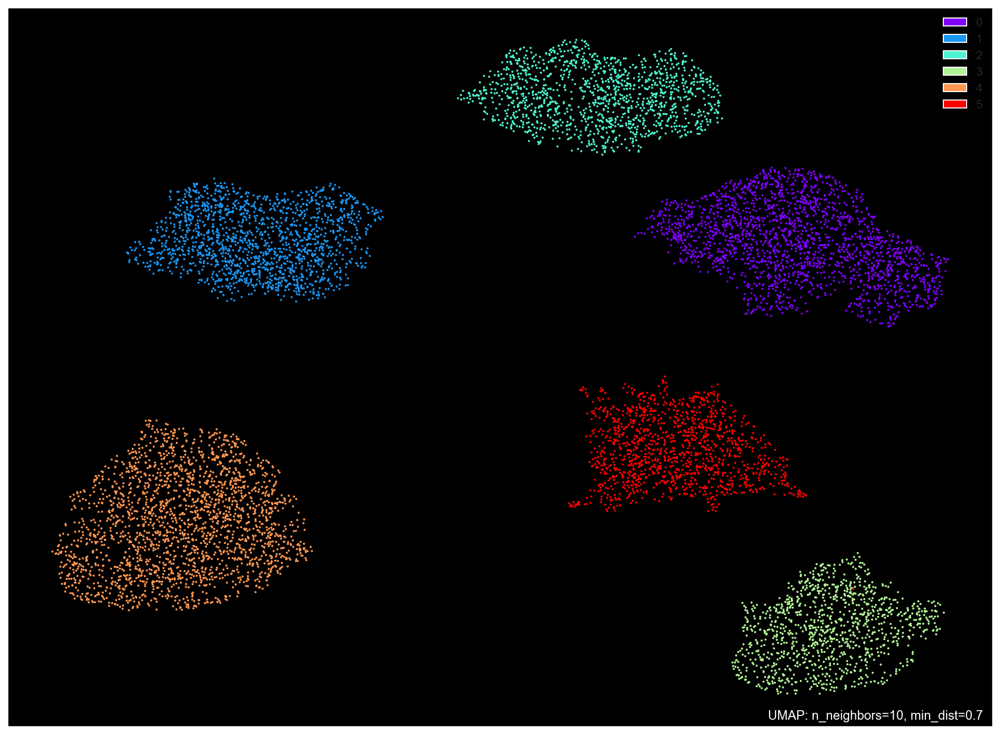

In [3701]:
umap.plot.points(manifold, labels=data['hc_labels_mf'], theme="fire", width = 1200 , height = 900);

In [3702]:
r2_variables(data[metric_features + ['hc_labels_mf']], 'hc_labels_mf').drop('hc_labels_mf')

MonthSal         0.661000
ClaimsRate       0.535008
PremMotor        0.762953
PremHousehold    0.448798
PremHealth       0.422697
PremLife         0.412346
PremWork         0.376735
dtype: float64

In [3703]:
# Preparing the data
X = data.drop(columns=['dbscan_labels_mf' ,'hc_labels_mf'])
y = data.hc_labels_mf

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=51
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=51, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 77.15% of the customers correctly


# K-means 

In [3704]:
range_clusters = range(1, 20)

### Elbow Method

In [3705]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=30, random_state=1)
    kmclust.fit(data[metric_features])
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution

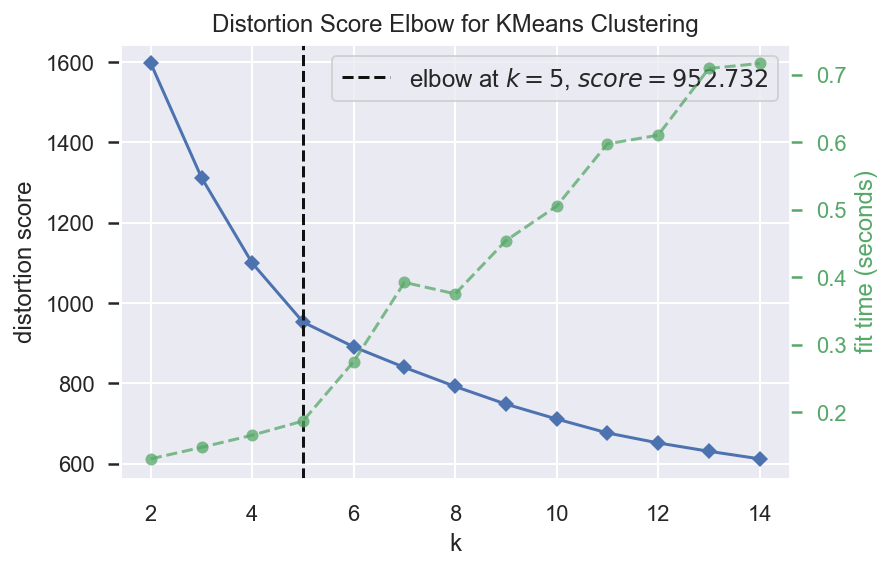

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [3706]:
# Elbow Method for K means
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,15), timings= True)
visualizer.fit(data[metric_features])     # Fit data to visualizer
visualizer.show()

### Gap Statistics 

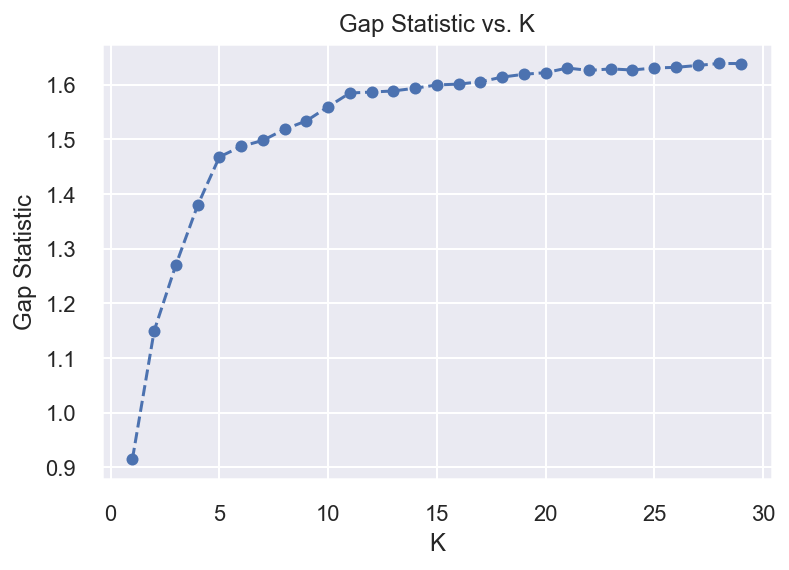

In [3707]:
# Gap Statistic for K means
def optimalK(data, nrefs=3, maxClusters=20):
    """
    Calculates KMeans optimal K using Gap Statistic 
    Params:
        data: ndarry of shape (n_samples, n_features)
        nrefs: number of sample reference datasets to create
        maxClusters: Maximum number of clusters to test for
    Returns: (gaps, optimalK)
    """
    gaps = np.zeros((len(range(1, maxClusters)),))
    resultsdf = pd.DataFrame({'clusterCount':[], 'gap':[]})
    for gap_index, k in enumerate(range(1, maxClusters)):
# Holder for reference dispersion results
        refDisps = np.zeros(nrefs)
# For n references, generate random sample and perform kmeans getting resulting dispersion of each loop
        for i in range(nrefs):
            
            # Create new random reference set
            randomReference = np.random.random_sample(size=data.shape)
            
            # Fit to it
            km = KMeans(k)
            km.fit(randomReference)
            
            refDisp = km.inertia_
            refDisps[i] = refDisp
# Fit cluster to original data and create dispersion
        km = KMeans(k)
        km.fit(data)
        
        origDisp = km.inertia_
# Calculate gap statistic
        gap = np.log(np.mean(refDisps)) - np.log(origDisp)
# Assign this loop's gap statistic to gaps
        gaps[gap_index] = gap
        
        resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)
    return (gaps.argmax() + 1, resultsdf)

score_g, df = optimalK(data[metric_features], nrefs=5, maxClusters=30)
plt.plot(df['clusterCount'], df['gap'], linestyle='--', marker='o', color='b');
plt.xlabel('K');
plt.ylabel('Gap Statistic');
plt.title('Gap Statistic vs. K');

# https://towardsdatascience.com/cheat-sheet-to-implementing-7-methods-for-selecting-optimal-number-of-clusters-in-python-898241e1d6ad

### Silhouette scores

For n_clusters = 2, the average silhouette_score is : 0.262167249437065
For n_clusters = 3, the average silhouette_score is : 0.24079826771391669
For n_clusters = 4, the average silhouette_score is : 0.2613935409045607
For n_clusters = 5, the average silhouette_score is : 0.26565113809263546
For n_clusters = 6, the average silhouette_score is : 0.25016519257133485
For n_clusters = 7, the average silhouette_score is : 0.23400094244318287
For n_clusters = 8, the average silhouette_score is : 0.23079125739480966
For n_clusters = 9, the average silhouette_score is : 0.22352709434269197
For n_clusters = 10, the average silhouette_score is : 0.22354005959700318
For n_clusters = 11, the average silhouette_score is : 0.22389702020613098
For n_clusters = 12, the average silhouette_score is : 0.22636407847603612
For n_clusters = 13, the average silhouette_score is : 0.21282363750924657
For n_clusters = 14, the average silhouette_score is : 0.2133044273449483
For n_clusters = 15, the average silh

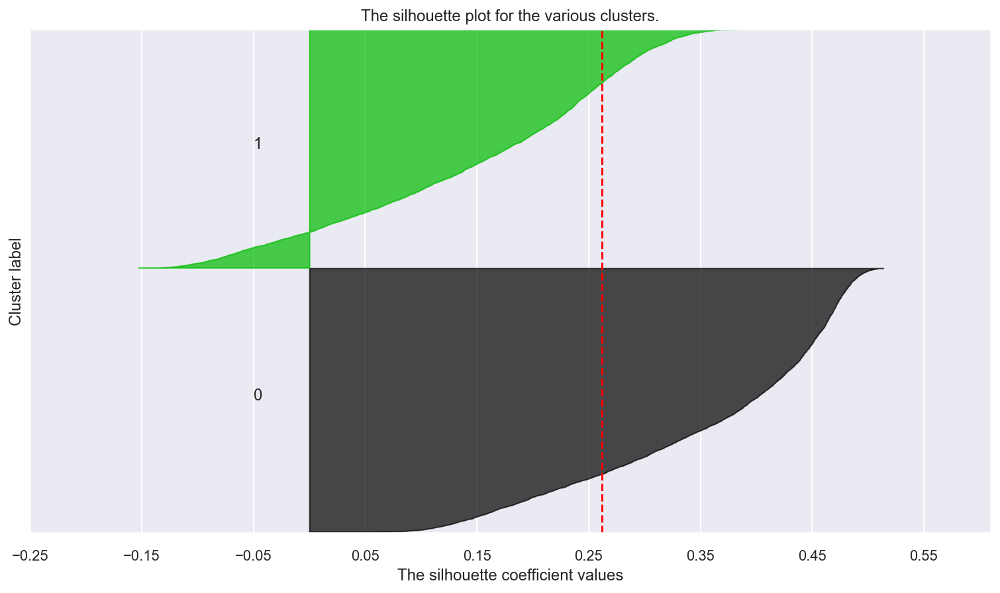

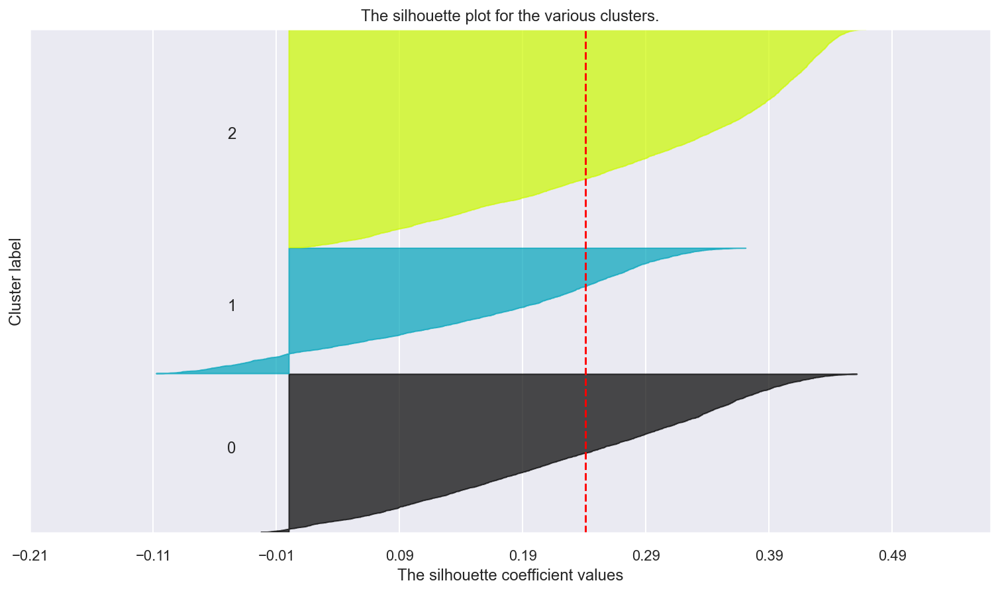

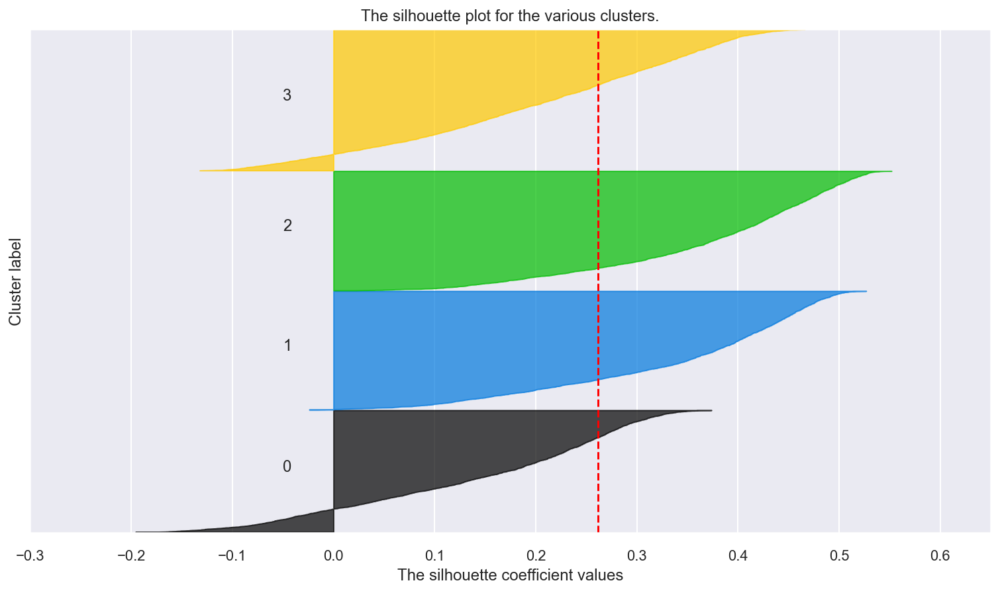

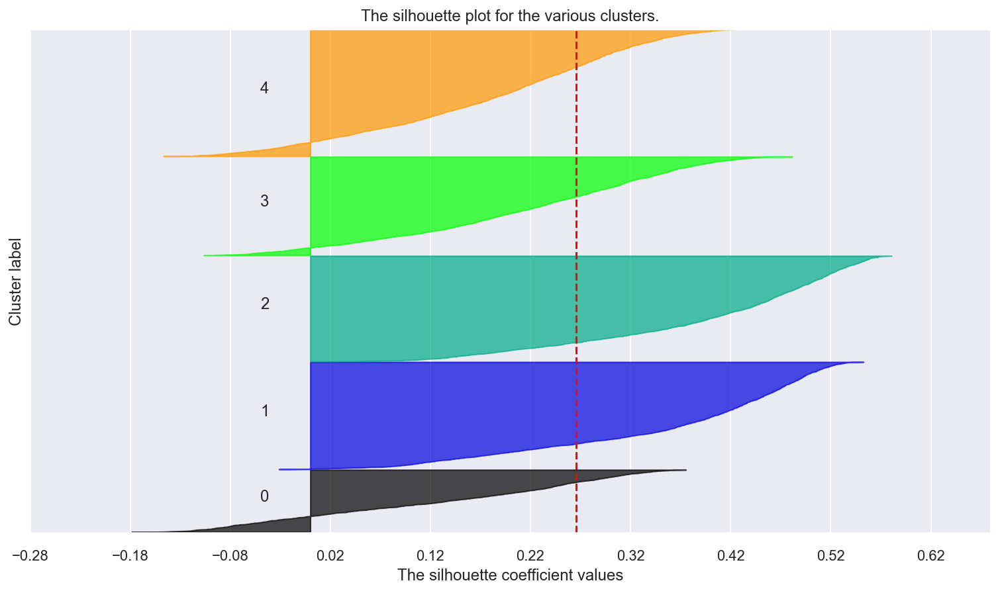

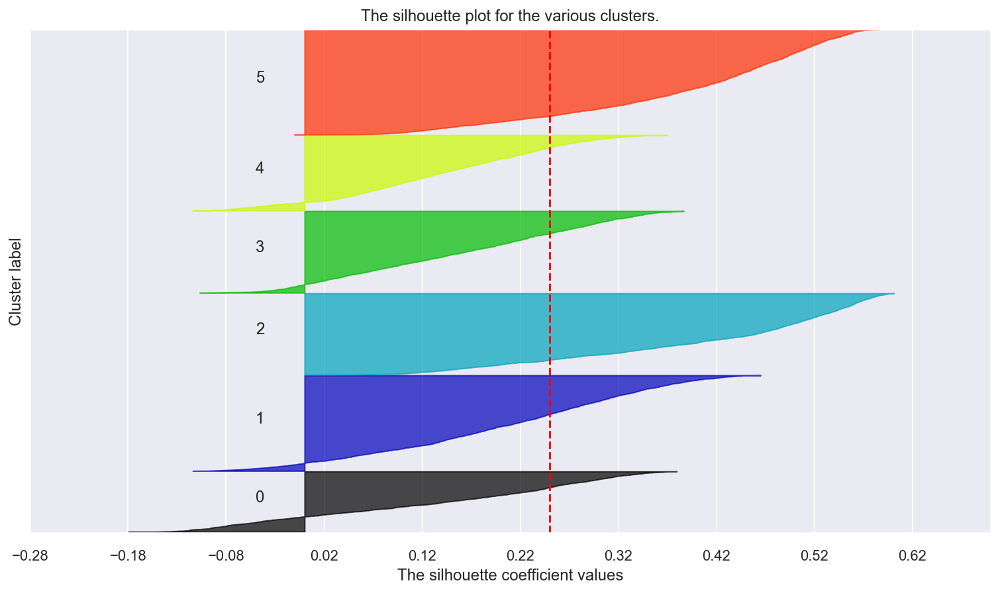

...

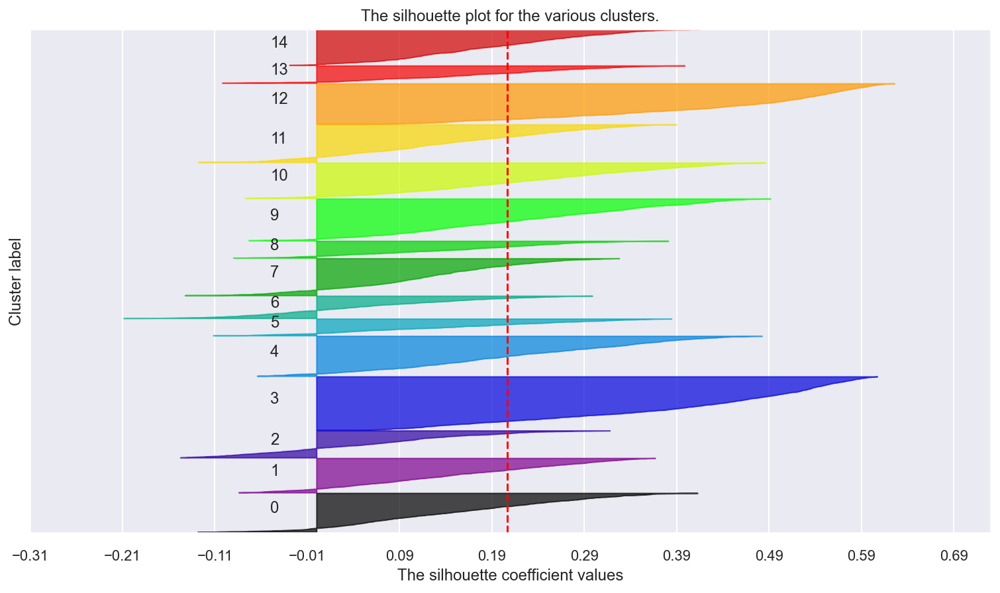

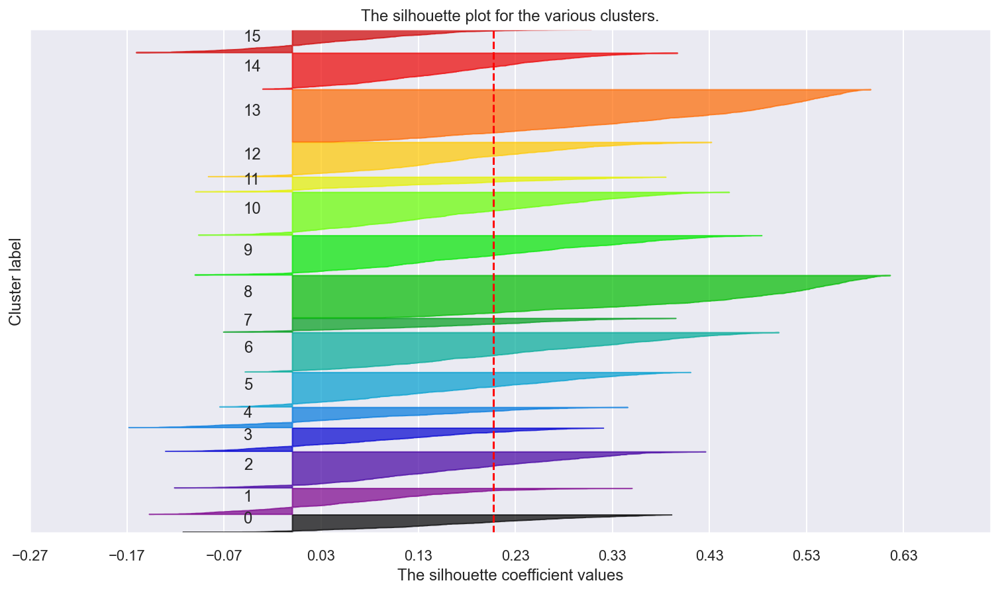

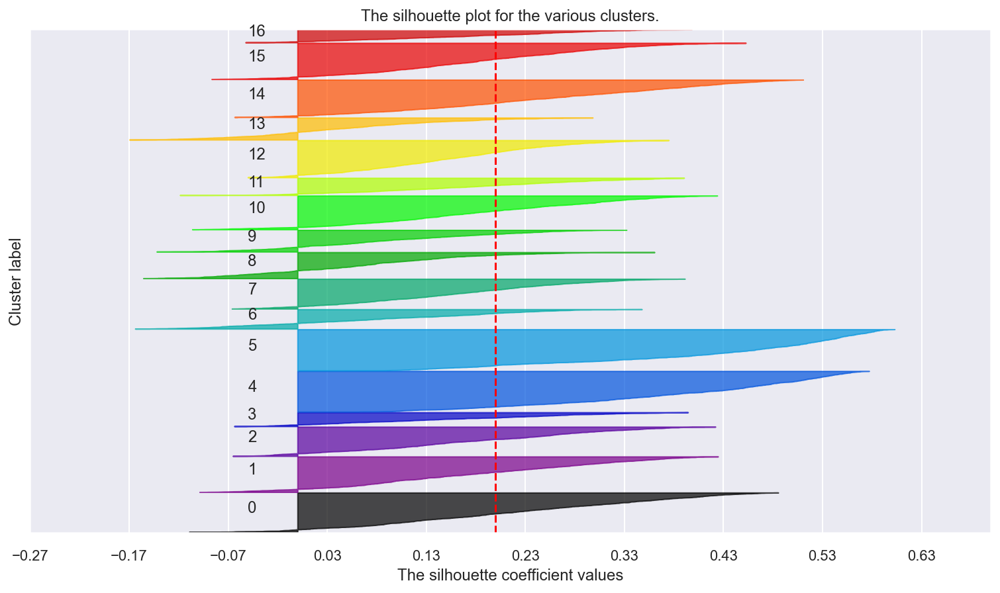

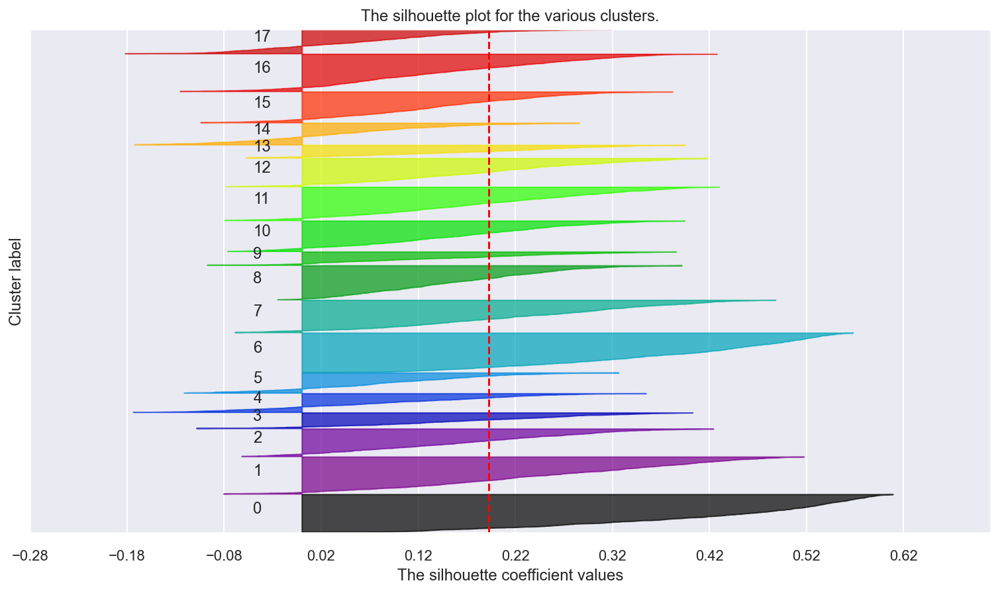

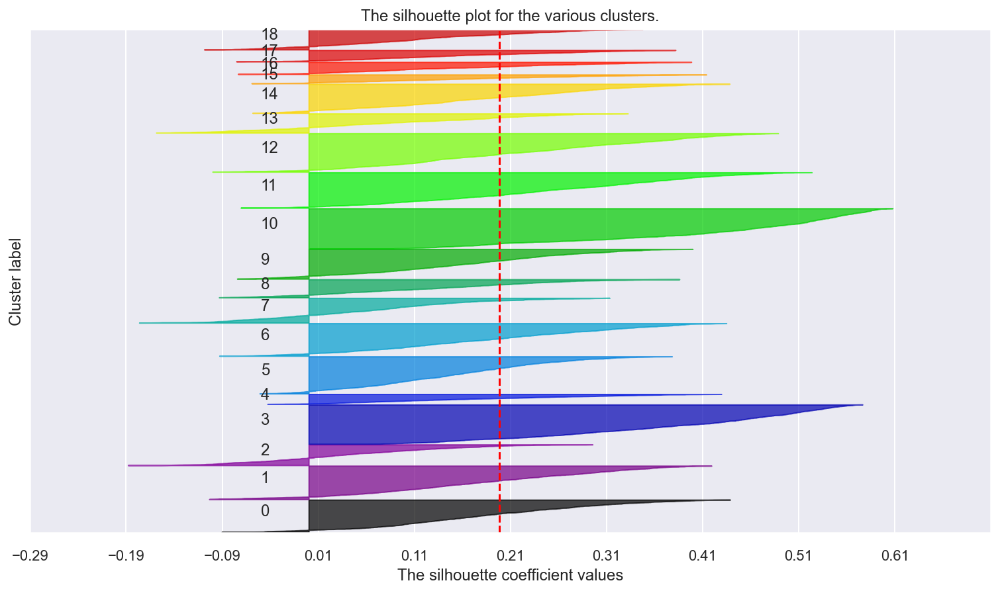

In [3708]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[metric_features])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(data[metric_features], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data[metric_features], cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(data[metric_features]) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

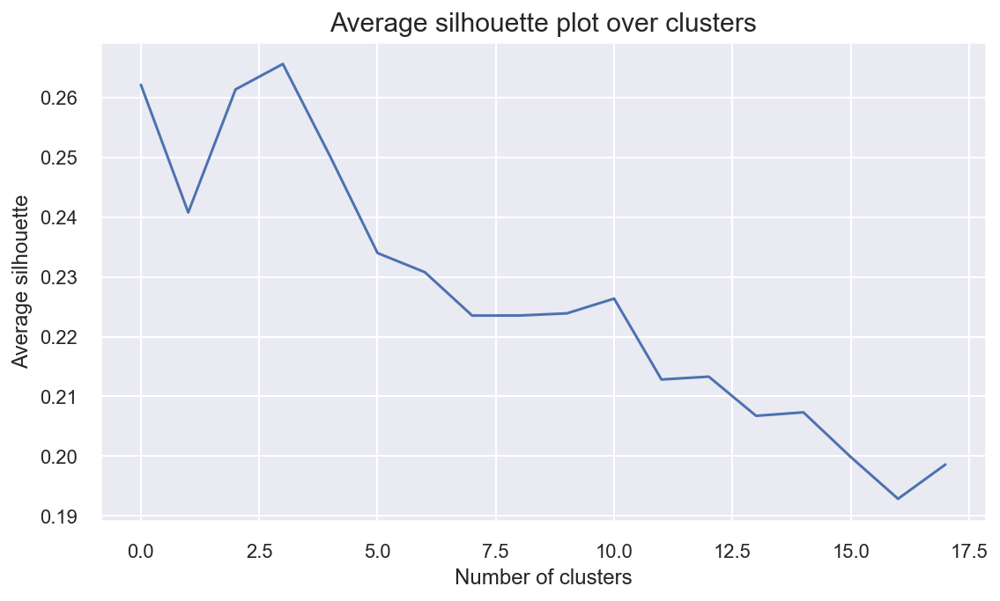

In [3709]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(avg_silhouette)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

### Final Solution

In [3710]:
# final cluster solution
number_clusters = 5
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels = kmclust.fit_predict(data[metric_features])
km_labels

array([1, 0, 0, ..., 1, 3, 1])

In [3711]:
# Characterizing the final clusters
df_concat_km = pd.concat((data, pd.Series(km_labels, name='labels')), axis=1)
df_concat_km.groupby('labels').mean()

,MonthSal,Children,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_70,x0_80,...,x2_1.0,x2_2.0,x2_3.0,x2_4.0,PC1,PC2,PC3,PC4,dbscan_labels_mf,hc_labels_mf
labels,,,,,,,,,,,,,,,,,,,,,
0.0,0.467364,0.721397,0.443407,0.517219,0.201711,0.421610,0.163440,0.158866,0.164192,0.465502,...,0.295197,0.093450,0.188646,0.422707,0.006299,-0.000947,-0.007044,-0.000810,0.0,2.396507
1.0,0.472253,0.700357,0.445115,0.521530,0.197552,0.419644,0.157751,0.162265,0.184788,0.441041,...,0.301174,0.091373,0.208780,0.398673,0.010084,-0.000813,-0.005590,-0.002672,0.0,2.409903
2.0,0.462096,0.700518,0.440640,0.514552,0.202877,0.420832,0.166255,0.161427,0.159067,0.460104,...,0.305181,0.104663,0.194819,0.395337,0.000563,-0.000441,-0.007410,0.000578,0.0,2.374611
3.0,0.457450,0.715484,0.445914,0.519505,0.199249,0.415068,0.162804,0.166280,0.175517,0.437675,...,0.280604,0.108999,0.204584,0.405813,-0.001727,0.008748,-0.005529,-0.000575,0.0,2.315260
4.0,0.471440,0.713293,0.440890,0.518023,0.202506,0.418373,0.160465,0.164036,0.172459,0.471329,...,0.297133,0.092963,0.202433,0.407472,0.005672,-0.004500,-0.002936,-0.003620,0.0,2.419635


In [3712]:
data['km_labels_mf'] = km_labels

In [3713]:
# Computing the R^2 of the cluster solution
sst = get_ss(data[metric_features])  # get total sum of squares
ssw_labels = data.groupby(by='km_labels_mf').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of -16.3550


#### T-SNE

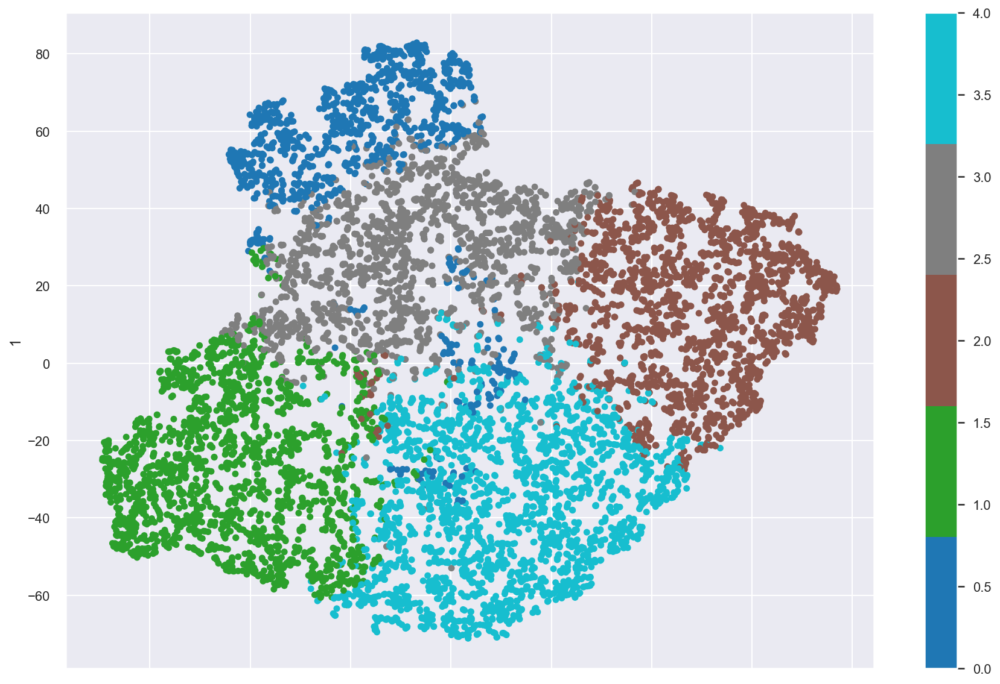

In [3771]:
tab10 = cm.get_cmap('tab10', 5)

# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=data['km_labels_mf'], colormap= tab10, figsize=(15,10))

plt.savefig(os.path.join('figures', 'tsne_km_mf.png'), dpi=200)
plt.show()

#### UMAP

In [3715]:
manifold = umap.UMAP(min_dist = 0.7 , n_neighbors = 10).fit(data[metric_features], data['km_labels_mf'])
X_reduced = manifold.transform(data[metric_features])

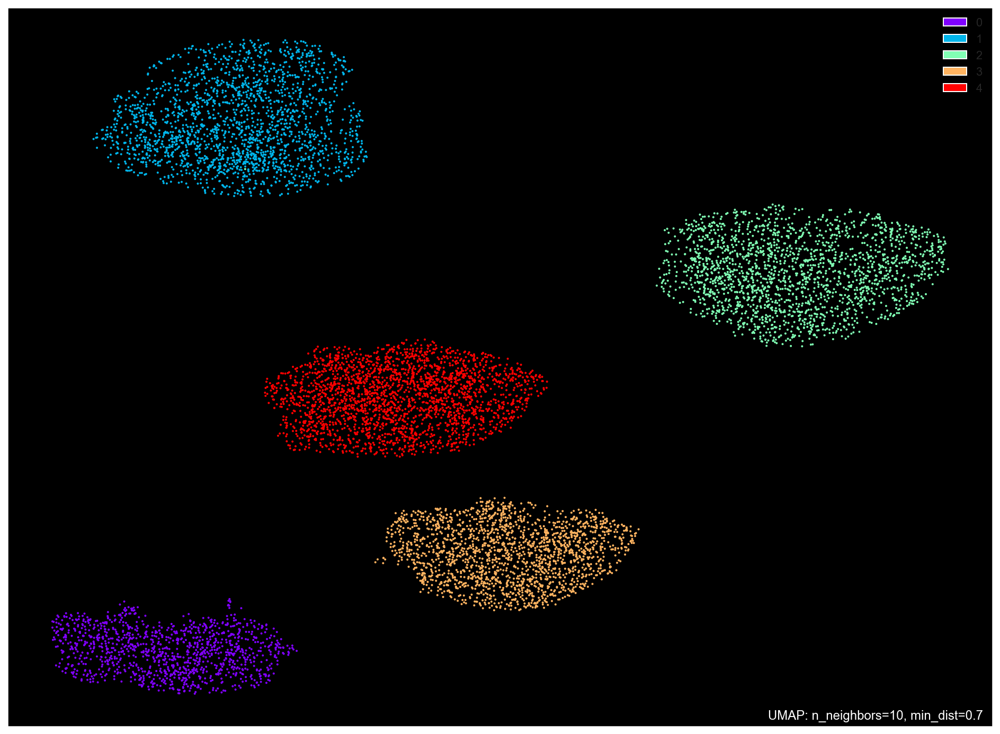

In [3716]:
umap.plot.points(manifold, labels=data['km_labels_mf'], theme="fire", width = 1200 , height = 900);

In [3717]:
r2_variables(data[metric_features + ['km_labels_mf']], 'km_labels_mf').drop('km_labels_mf')

MonthSal         0.639592
ClaimsRate       0.553987
PremMotor        0.758722
PremHousehold    0.474491
PremHealth       0.502197
PremLife         0.453886
PremWork         0.414856
dtype: float64

In [3718]:
# Preparing the data
X = data.drop(columns=['dbscan_labels_mf' ,'hc_labels_mf', 'km_labels_mf'])
y = data.km_labels_mf

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=51
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=51, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 87.52% of the customers correctly


## DensityBased 

In [3719]:
# The following bandwidth can be automatically detected using (we need to set quantile though)
# Based on distance to nearest neighbors for all observations
bandwidth = estimate_bandwidth(data[metric_features], quantile=0.06, random_state=1, n_jobs=-1)
bandwidth

0.31808949423896216

In [3720]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(data[metric_features])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 2


In [3721]:
# Concatenating the labels to df
df_concat_ms = pd.concat([data[metric_features], pd.Series(ms_labels, index=data.index, name="ms_labels")], axis=1)
df_concat_ms.head()

,MonthSal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,ms_labels
CustID,,,,,,,,
1,0.393345,0.253247,0.644732,0.113408,0.361663,0.188372,0.093043,1
2,0.073379,0.727273,0.138411,0.360673,0.289389,0.702706,0.380451,0
3,0.414676,0.181818,0.356778,0.219913,0.308609,0.325579,0.357552,1
4,0.163396,0.642857,0.316614,0.086901,0.763130,0.147670,0.129919,0
5,0.305034,0.584416,0.581559,0.090168,0.449917,0.089914,0.172142,0


In [3722]:
data['ms_labels_mf'] = ms_labels

In [3723]:
# Computing the R^2 of the cluster solution
sst = get_ss(data[metric_features])  # get total sum of squares
ssw_labels = data.groupby(by='ms_labels_mf').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of -30.2077


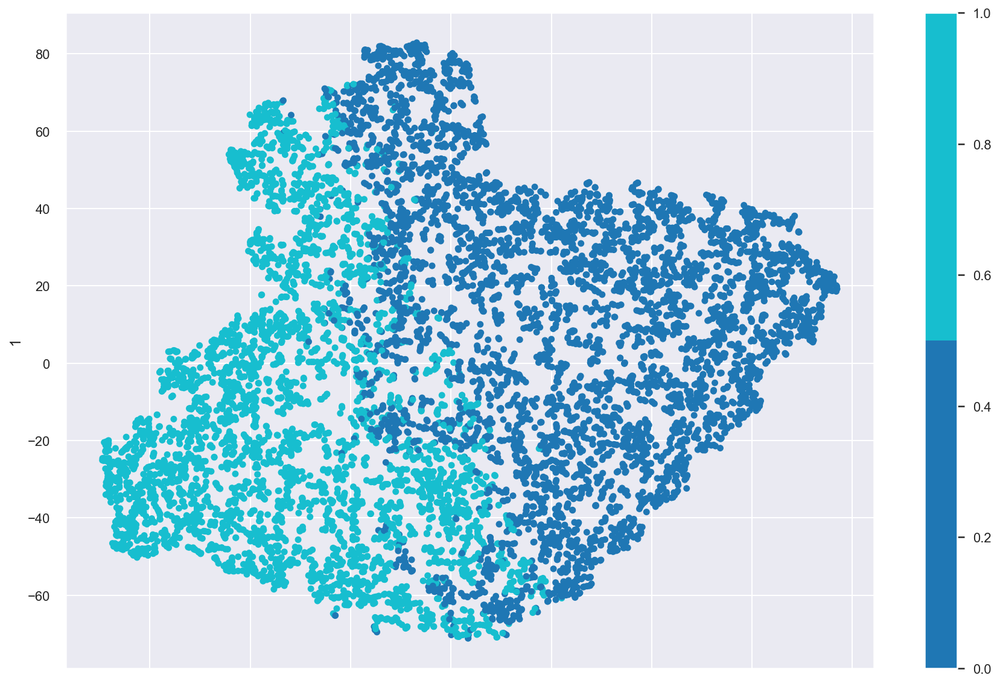

In [3724]:
tab10 = cm.get_cmap('tab10', 2)

# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=data['ms_labels_mf'], colormap= tab10, figsize=(15,10))
plt.show()

In [3725]:
manifold = umap.UMAP(min_dist = 0.8 , n_neighbors= 12).fit(data[metric_features], data['ms_labels_mf'])
X_reduced = manifold.transform(data[metric_features])

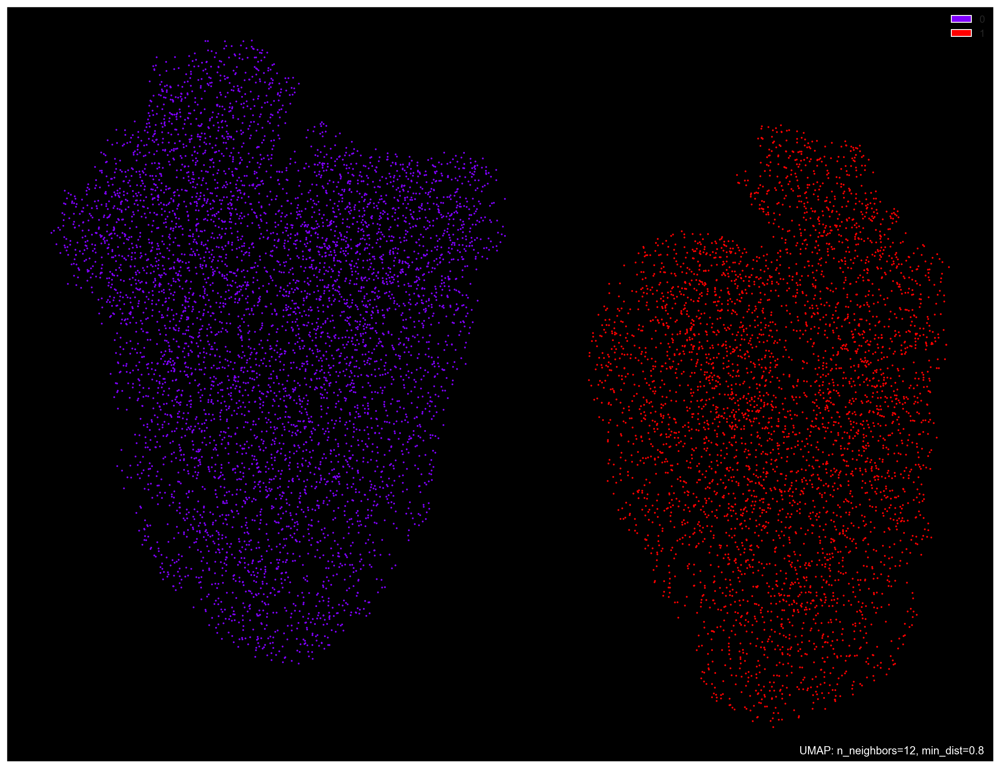

In [3726]:
umap.plot.points(manifold, labels=data['ms_labels_mf'], theme="fire", width = 1400 , height = 1100);

We won't be considering this solution

## Profilling each solution

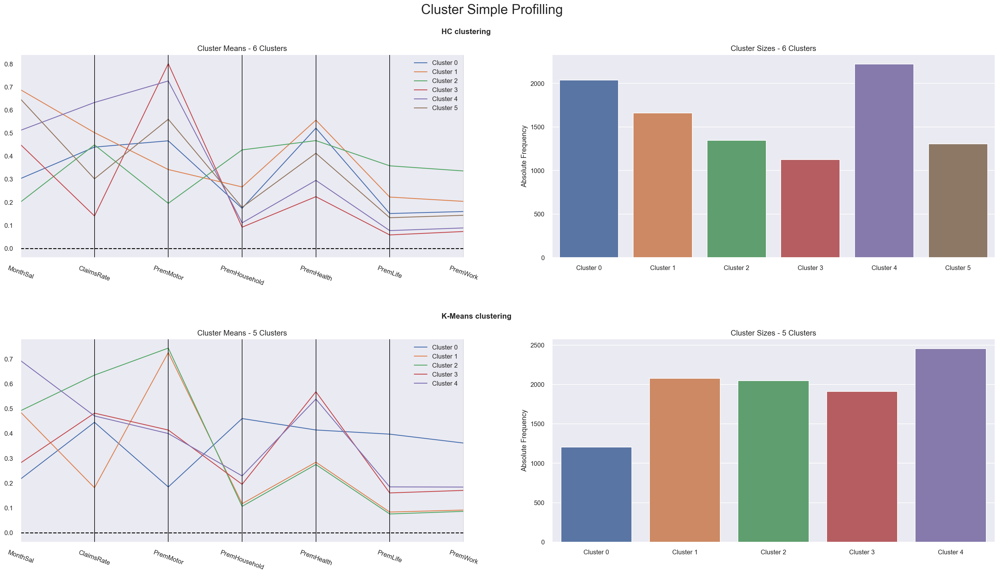

In [3727]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = data[metric_features + ['hc_labels_mf', 'km_labels_mf']], 
    label_columns = ['hc_labels_mf', 'km_labels_mf'], 
    figsize = (30, 15), 
    compar_titles = ["HC clustering", "K-Means clustering"]
)

From the clustering methods used on the metric features we reached these two set of clusters, kmean's one having a better
prediction score with 88.31% as well as a slightly more evenly distributed classes. 

## Different Segmentation

Different segmentation using different segments and merging them later on.

In [3728]:
premium_features = [
    'PremMotor',
    'PremHousehold',
    'PremHealth',
    'PremWork',
    'PremLife',
    'ClaimsRate'
]

demographic_features = data.columns.drop(premium_features + pca_features + ['hc_labels_mf', 'dbscan_labels_mf', 'km_labels_mf', 'ms_labels_mf']).to_list()

In [3729]:
demographic_features

['MonthSal',
 'Children',
 'x0_70',
 'x0_80',
 'x0_90',
 'x1_BSc/MSc',
 'x1_Basic',
 'x1_High School',
 'x1_PhD',
 'x2_1.0',
 'x2_2.0',
 'x2_3.0',
 'x2_4.0']

In [3730]:
df_dem = data[demographic_features].copy()
df_prem = data[premium_features].copy()

In [3731]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
    
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust


# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

In [3732]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_dem, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_dem, hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
2,0.177387,0.090068,0.172535,0.001685,0.116063
3,0.276684,0.184460,0.286584,0.005831,0.214247
4,0.359727,0.267751,0.343902,0.010146,0.302238
5,0.425496,0.346934,0.373386,0.013494,0.363057
6,0.457111,0.382680,0.389736,0.017479,0.407543
7,0.506606,0.437507,0.410052,0.025752,0.451813
8,0.529508,0.456680,0.439157,0.028940,0.488146
9,0.558633,0.478871,0.501295,0.036721,0.521797


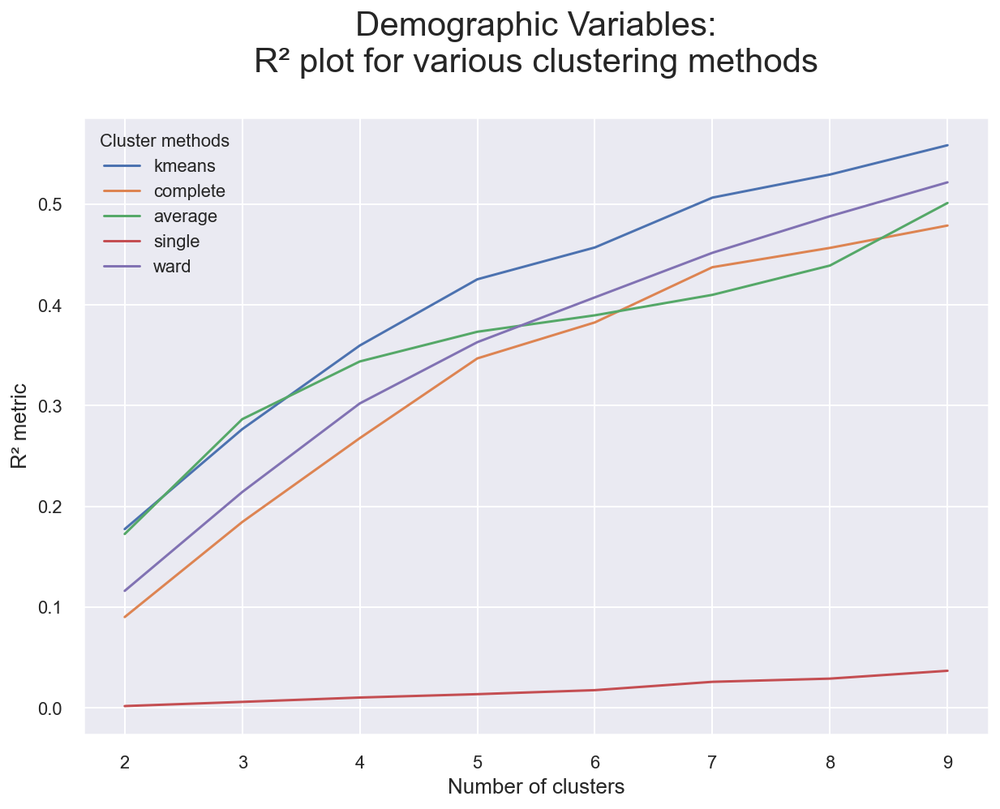

In [3733]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Demographic Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

In [3734]:
# Obtaining the R² scores for each cluster solution on product variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_prem, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_prem, hierarchical.set_params(linkage=linkage)
    )
    
pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
2,0.358037,0.300600,0.000301,0.000435,0.301386
3,0.480177,0.411858,0.202415,0.000975,0.425983
4,0.586961,0.429155,0.224864,0.001484,0.534380
5,0.633555,0.446628,0.244907,0.001659,0.579389
6,0.666576,0.509172,0.254891,0.001943,0.611990
7,0.694650,0.515953,0.415266,0.002537,0.638718
8,0.713613,0.521901,0.427066,0.002827,0.659600
9,0.728751,0.534319,0.428837,0.003430,0.680346


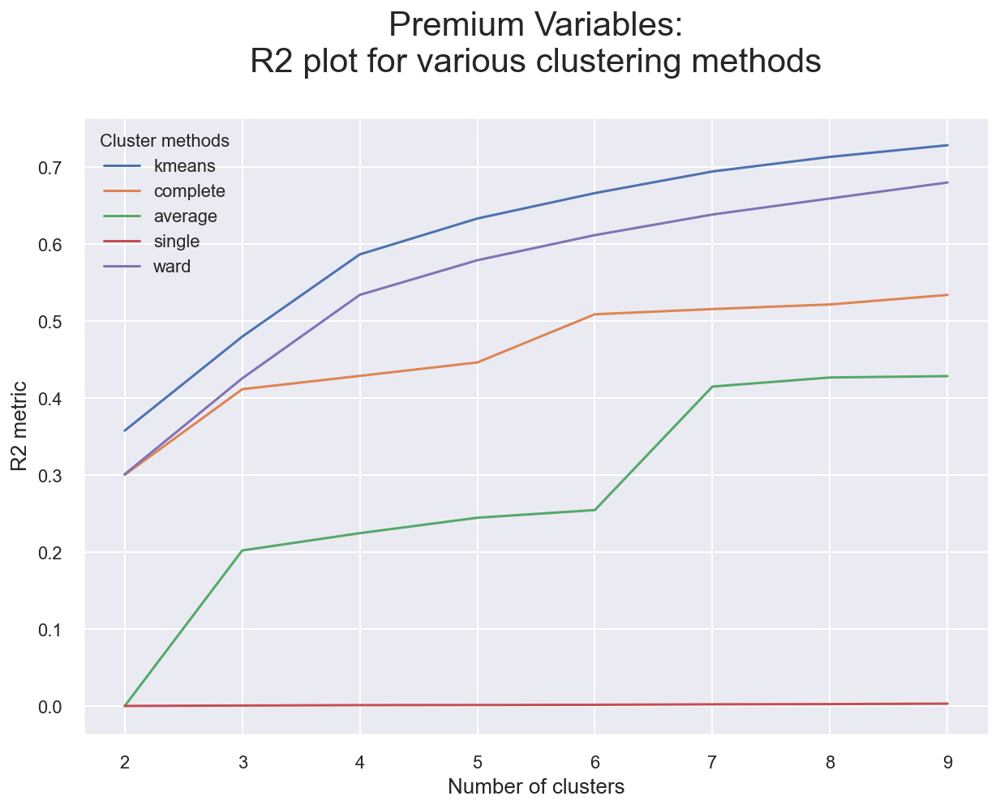

In [3735]:
# Visualizing the R² scores for each cluster solution on product variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Premium Variables:\nR2 plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
plt.show()

In [3736]:
# Applying the right clustering (algorithm and number of clusters) for each perspective
kmeans_prem = KMeans(
    n_clusters=4,
    init='k-means++',
    n_init=20,
    random_state=42
)
prem_labels = kmeans_prem.fit_predict(df_prem)

kmeans_behav = KMeans(
    n_clusters=5,
    init='k-means++',
    n_init=20,
    random_state=42
)
behavior_labels = kmeans_behav.fit_predict(df_dem)

data['premium_labels'] = prem_labels
data['behavior_labels'] = behavior_labels

In [3754]:
# Count label frequencies (contigency table)
data.groupby(['premium_labels', 'behavior_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('behavior_labels', 'premium_labels', 0)

premium_labels,0,1,2,3
behavior_labels,,,,
0,146,423,526,391
1,334,497,852,460
2,128,498,530,510
3,950,276,635,273
4,100,665,843,658


In [3755]:
# Clusters with low frequency to be merged:
to_merge = [(0,0), (4,0), (2,0)]

df_centroids = data.groupby(['behavior_labels', 'premium_labels'])\
    [metric_features].mean()

# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(0, 0): (3, 0), (4, 0): (1, 0), (2, 0): (1, 0)}

In [3756]:
df_ = data.copy()

# Changing the behavior_labels and product_labels based on source_target
for source, target in source_target.items():
    mask = (df_['behavior_labels']==source[0]) & (df_['premium_labels']==source[1])
    df_.loc[mask, 'behavior_labels'] = target[0]
    df_.loc[mask, 'premium_labels'] = target[1]

# New contigency table
df_.groupby(['premium_labels', 'behavior_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('behavior_labels', 'premium_labels', 0)

premium_labels,0,1,2,3
behavior_labels,,,,
0,NaN,423.0,526.0,391.0
1,562.0,497.0,852.0,460.0
2,NaN,498.0,530.0,510.0
3,1096.0,276.0,635.0,273.0
4,NaN,665.0,843.0,658.0


### Merging using HC

In [3757]:
# Centroids of the concatenated cluster labels
df_centroids = data.groupby(['behavior_labels', 'premium_labels'])\
    [metric_features].mean()
df_centroids

MonthSal  ClaimsRate  PremMotor  \
behavior_labels premium_labels                                    
0               0               0.280351    0.374933   0.234022   
                1               0.490522    0.185195   0.714841   
                2               0.486801    0.479594   0.392298   
                3               0.499982    0.631631   0.735589   
1               0               0.478882    0.434754   0.282559   
                1               0.469961    0.200933   0.686130   
                2               0.454993    0.498323   0.390951   
                3               0.467696    0.628656   0.711987   
2               0               0.627476    0.449980   0.295712   
                1               0.531586    0.190581   0.716676   
                2               0.632774    0.491669   0.405581   
                3               0.529060    0.633130   0.737896   
3               0               0.247629    0.438817   0.170992   
                1               0.490007    0.192076   0.693859   
                2               0.472560    0.504315   0.355124   
                3               0.491654    0.625874   0.710752   
4               0               0.408530    0.401558   0.322528   
                1               0.464679    0.194893   0.708407   
                2               0.476860    0.488654   0.423416   
                3               0.475453    0.635466   0.726632   

                                PremHousehold  PremHealth  PremLife  PremWork  
behavior_labels premium_labels                                                 
0               0                    0.427152    0.458020  0.318365  0.305207  
                1                    0.117275    0.306155  0.080375  0.087162  
                2                    0.193693    0.604049  0.158180  0.166597  
                3                    0.107687    0.290708  0.076112  0.086051  
1               0                    0.404470    0.416444  0.313356  0.294825  
                1                    0.139248    0.305645  0.099617  0.107756  
                2                    0.197594    0.576274  0.180156  0.182548  
                3                    0.117139    0.292177  0.090904  0.100314  
2               0                    0.421705    0.412824  0.300590  0.275721  
                1                    0.120339    0.290431  0.087328  0.095148  
                2                    0.197565    0.575295  0.168036  0.168434  
                3                    0.112602    0.272239  0.082877  0.088911  
3               0                    0.468195    0.416525  0.403684  0.372285  
                1                    0.126668    0.298944  0.099237  0.108549  
                2                    0.211324    0.597912  0.193057  0.194198  
                3                    0.120842    0.285676  0.091527  0.103877  
4               0                    0.421223    0.390109  0.277430  0.279254  
                1                    0.119251    0.307922  0.082089  0.092411  
                2                    0.184238    0.586567  0.146377  0.150485  
                3                    0.104293    0.302740  0.072796  0.084466

In [3758]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

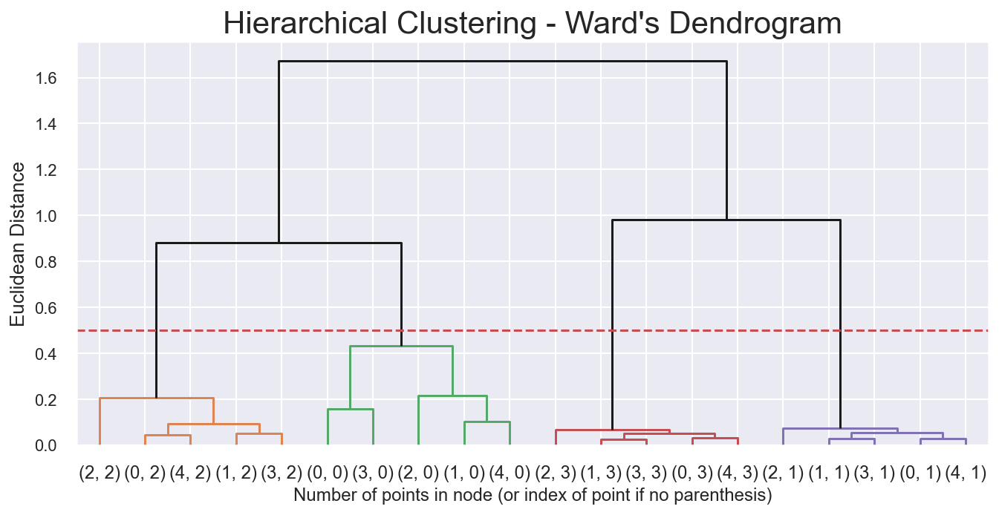

In [3759]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 0.50
dendrogram(linkage_matrix, truncate_mode='level', labels=df_centroids.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [3760]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=4
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

MonthSal  ClaimsRate  PremMotor  \
behavior_labels premium_labels                                    
0               0               0.280351    0.374933   0.234022   
                1               0.490522    0.185195   0.714841   
                2               0.486801    0.479594   0.392298   
                3               0.499982    0.631631   0.735589   
1               0               0.478882    0.434754   0.282559   
                1               0.469961    0.200933   0.686130   
                2               0.454993    0.498323   0.390951   
                3               0.467696    0.628656   0.711987   
2               0               0.627476    0.449980   0.295712   
                1               0.531586    0.190581   0.716676   
                2               0.632774    0.491669   0.405581   
                3               0.529060    0.633130   0.737896   
3               0               0.247629    0.438817   0.170992   
                1               0.490007    0.192076   0.693859   
                2               0.472560    0.504315   0.355124   
                3               0.491654    0.625874   0.710752   
4               0               0.408530    0.401558   0.322528   
                1               0.464679    0.194893   0.708407   
                2               0.476860    0.488654   0.423416   
                3               0.475453    0.635466   0.726632   

                                PremHousehold  PremHealth  PremLife  PremWork  \
behavior_labels premium_labels                                                  
0               0                    0.427152    0.458020  0.318365  0.305207   
                1                    0.117275    0.306155  0.080375  0.087162   
                2                    0.193693    0.604049  0.158180  0.166597   
                3                    0.107687    0.290708  0.076112  0.086051   
1               0                    0.404470    0.416444  0.313356  0.294825   
                1                    0.139248    0.305645  0.099617  0.107756   
                2                    0.197594    0.576274  0.180156  0.182548   
                3                    0.117139    0.292177  0.090904  0.100314   
2               0                    0.421705    0.412824  0.300590  0.275721   
                1                    0.120339    0.290431  0.087328  0.095148   
                2                    0.197565    0.575295  0.168036  0.168434   
                3                    0.112602    0.272239  0.082877  0.088911   
3               0                    0.468195    0.416525  0.403684  0.372285   
                1                    0.126668    0.298944  0.099237  0.108549   
                2                    0.211324    0.597912  0.193057  0.194198   
                3                    0.120842    0.285676  0.091527  0.103877   
4               0                    0.421223    0.390109  0.277430  0.279254   
                1                    0.119251    0.307922  0.082089  0.092411   
                2                    0.184238    0.586567  0.146377  0.150485   
                3                    0.104293    0.302740  0.072796  0.084466   

                                hclust_labels  
behavior_labels premium_labels                 
0               0                           0  
                1                           3  
                2                           1  
                3                           2  
1               0                           0  
                1                           3  
                2                           1  
                3                           2  
2               0                           0  
                1                           3  
                2                           1  
                3                           2  
3               0                           0  
                1                           3  
      

In [3761]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_ = data.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['behavior_labels'], row['premium_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()[metric_features]

,MonthSal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
merged_labels,,,,,,,
0,0.336125,0.430988,0.217785,0.445322,0.418284,0.362401,0.337708
1,0.496500,0.493088,0.394814,0.196233,0.587056,0.168854,0.172063
2,0.491938,0.631782,0.725836,0.111270,0.289748,0.081470,0.091218
3,0.487514,0.193187,0.704911,0.124207,0.302383,0.088587,0.097169


In [3762]:
data = df_.copy()

## Clusatering Analysis

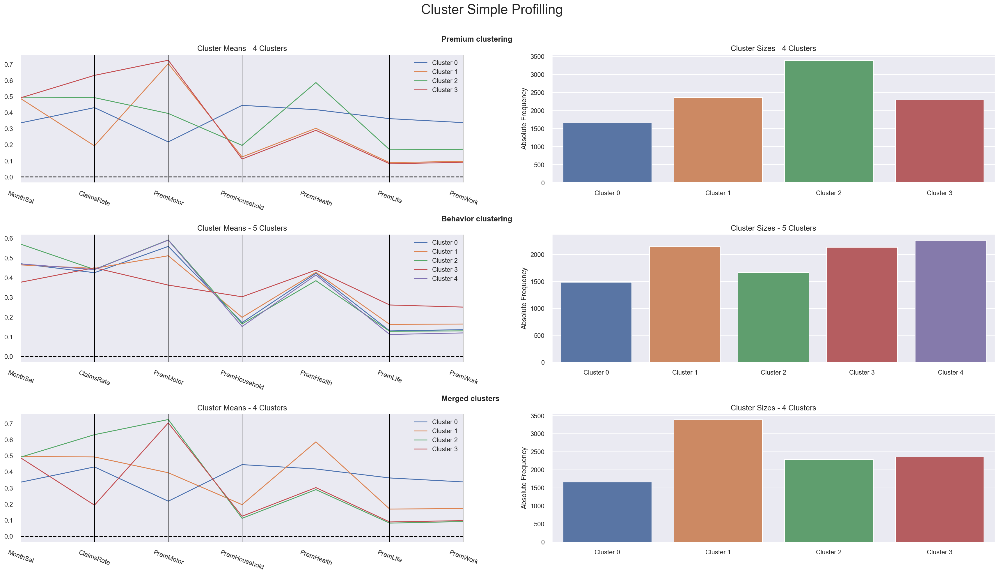

In [3763]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = data[metric_features + ['premium_labels', 'behavior_labels', 'merged_labels']], 
    label_columns = ['premium_labels', 'behavior_labels', 'merged_labels'], 
    figsize = (30, 15), 
    compar_titles = ["Premium clustering", "Behavior clustering", "Merged clusters"]
)

### t-SNE visualization

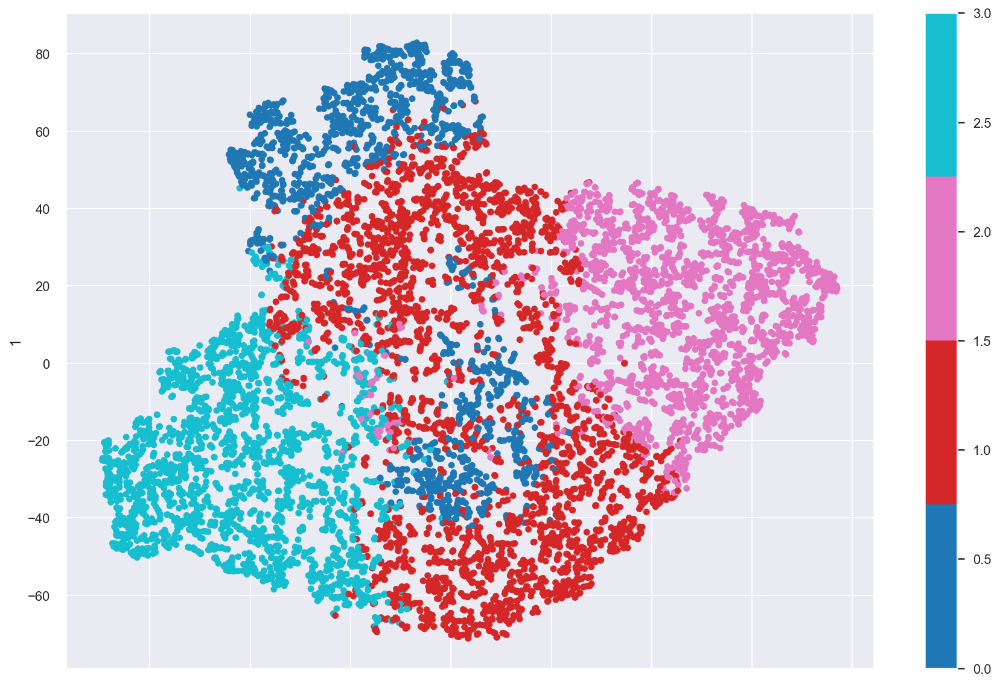

In [3772]:
tab10 = cm.get_cmap('tab10', 4)

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=data['merged_labels'], colormap=tab10, figsize=(15,10))
plt.savefig(os.path.join('figures', 'tsne_km_merged.png'), dpi=200)

plt.show()

### UMAP visualization

In [3765]:
mapper = umap.UMAP(min_dist = 1 , n_neighbors= 15).fit(data[metric_features])

In [3766]:
manifold = umap.UMAP(min_dist = 1 , n_neighbors= 15).fit(data[metric_features], data['merged_labels'])
X_reduced = manifold.transform(data[metric_features])

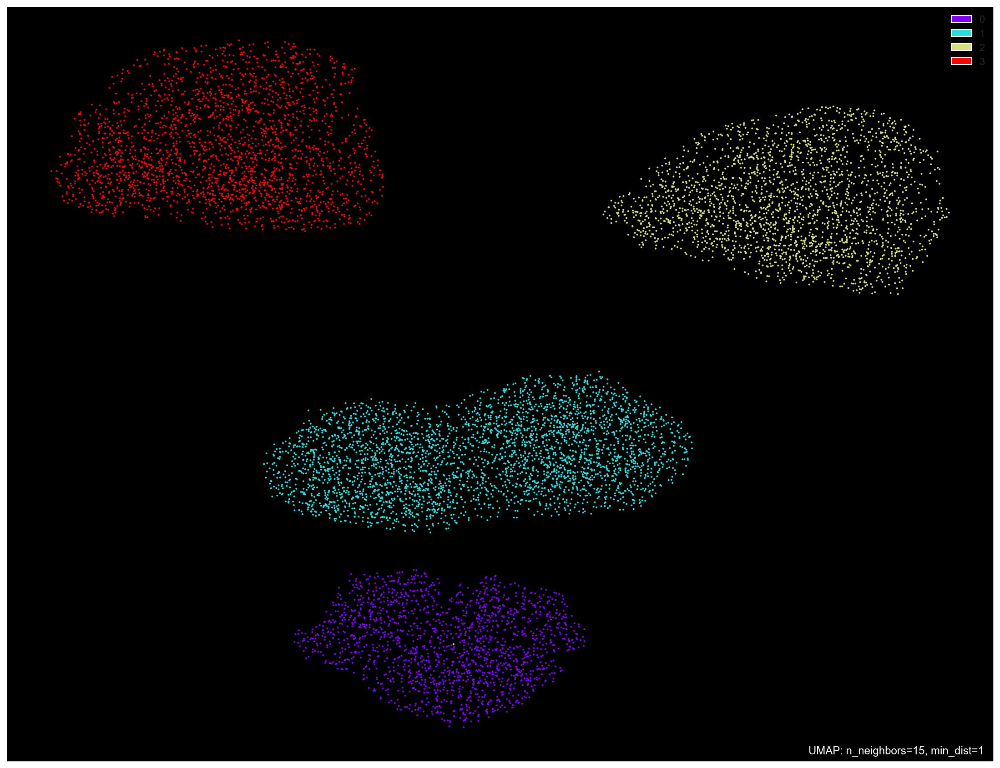

In [3767]:
umap.plot.points(manifold, labels=data['merged_labels'], theme="fire", width = 1400 , height = 1100);

In [3768]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(data[metric_features + ['merged_labels']], 'merged_labels').drop('merged_labels')

MonthSal         0.080370
ClaimsRate       0.592233
PremMotor        0.756542
PremHousehold    0.538450
PremHealth       0.528989
PremLife         0.446111
PremWork         0.424180
dtype: float64

In [3769]:
# Preparing the data
X = data.drop(columns=['dbscan_labels_mf' ,'hc_labels_mf', 'km_labels_mf', 'ms_labels_mf', 'premium_labels','behavior_labels','merged_labels'])
y = data.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=51
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=51, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 88.65% of the customers correctly


Just slightly better result than our K-means and Hc ones, around the same 88 to 89% prediction score.